#### Packages and Visualization

In [ ]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [ ]:
class Generator(nn.Module):

    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [ ]:
import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
       return F.one_hot(labels,n_classes)

In [1]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
  return (torch.cat((x.float(), y.float()), 1))

In [ ]:
mnist_shape = (1, 28, 28)
n_classes = 10

In [ ]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [ ]:
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    generator_input_dim = z_dim+n_classes
    discriminator_im_chan = mnist_shape[0]+n_classes
    return generator_input_dim, discriminator_im_chan

In [ ]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.2383985373973845, discriminator loss: 0.2577083580493927


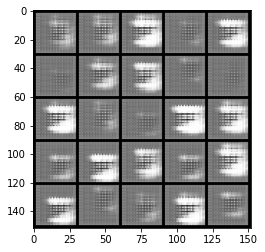

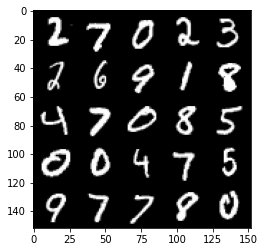

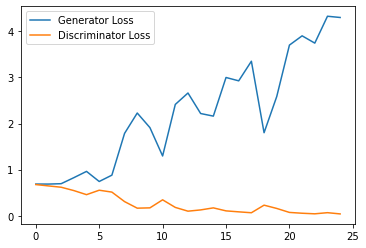

Step 1000: Generator loss: 4.578961500167846, discriminator loss: 0.05867728965450078


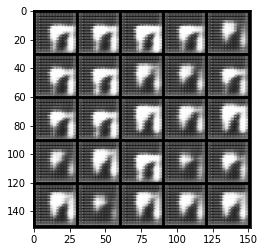

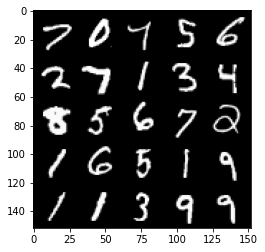

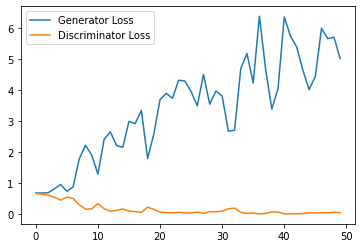

Step 1500: Generator loss: 4.256449307918548, discriminator loss: 0.055911628119647505


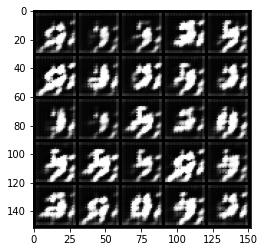

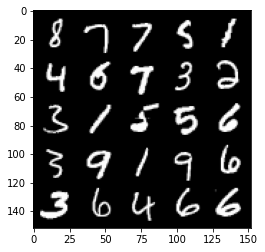

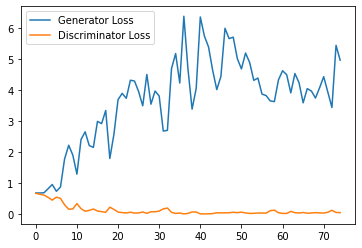

Step 2000: Generator loss: 3.4257822268009184, discriminator loss: 0.12505626276880502


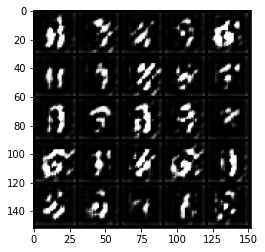

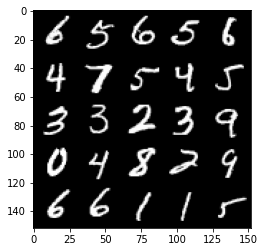

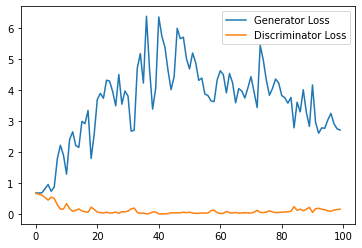

Step 2500: Generator loss: 2.5213006174564363, discriminator loss: 0.2603876392394304


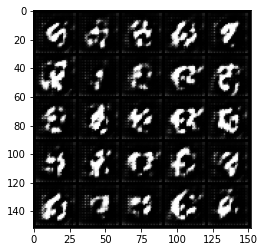

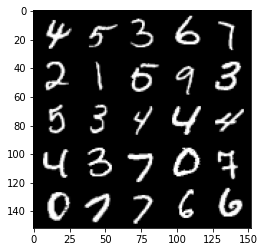

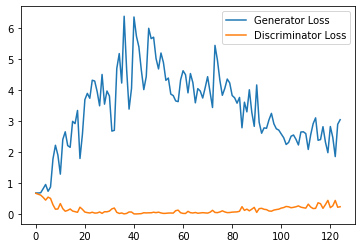

Step 3000: Generator loss: 2.0566445815563204, discriminator loss: 0.3083989879190922


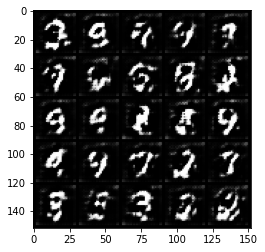

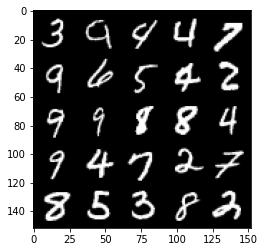

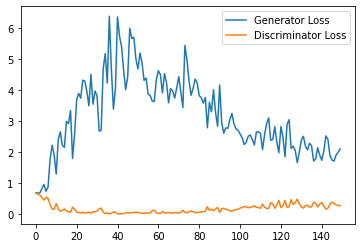

Step 3500: Generator loss: 2.114477031946182, discriminator loss: 0.300122344955802


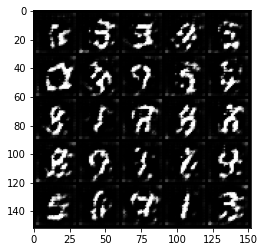

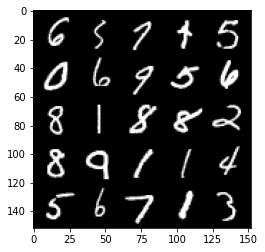

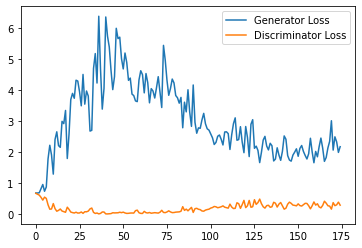

Step 4000: Generator loss: 1.9609821870326996, discriminator loss: 0.33591389763355256


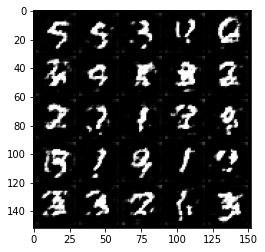

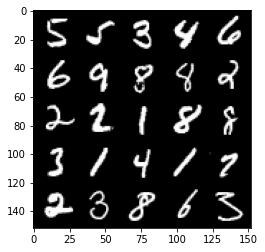

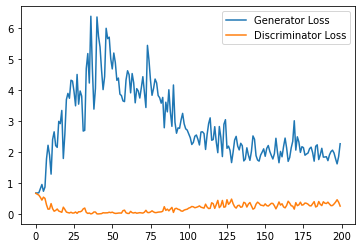

Step 4500: Generator loss: 1.8875793573856354, discriminator loss: 0.34820534563064576


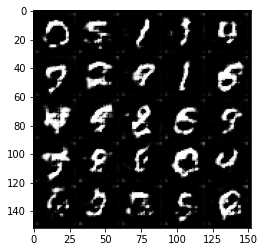

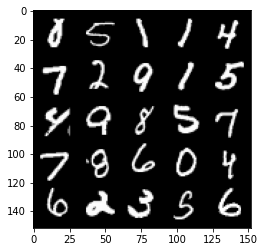

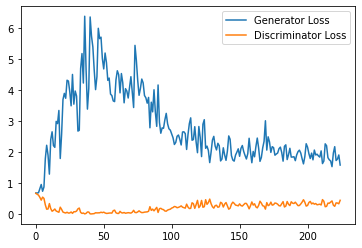

Step 5000: Generator loss: 1.9874851620197296, discriminator loss: 0.37031996887922286


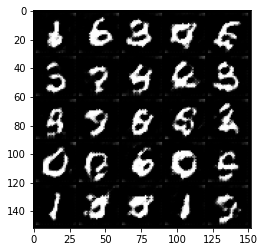

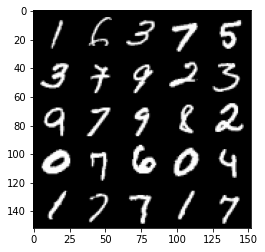

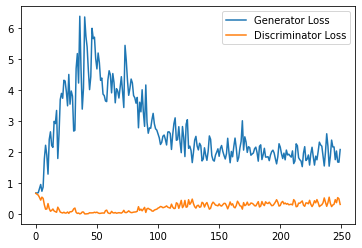

Step 5500: Generator loss: 1.7803762800693512, discriminator loss: 0.3923682405948639


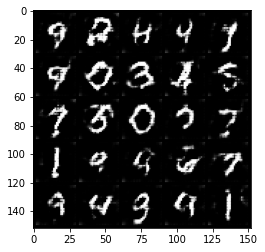

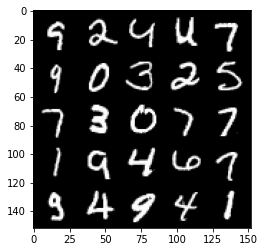

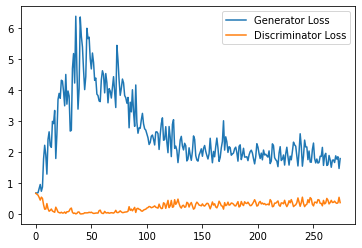

Step 6000: Generator loss: 1.6113161042928696, discriminator loss: 0.4075969281792641


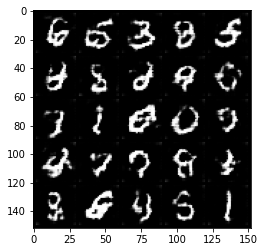

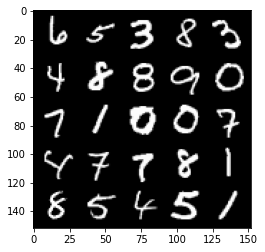

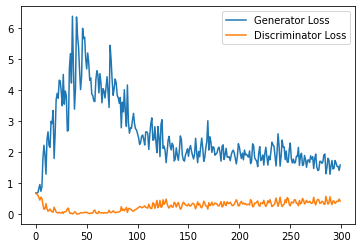

Step 6500: Generator loss: 1.6610634038448333, discriminator loss: 0.4352490731179714


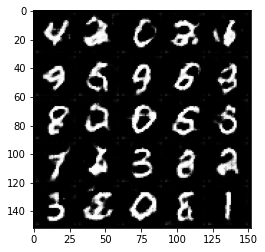

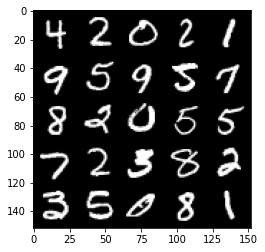

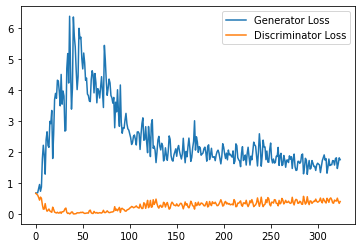

Step 7000: Generator loss: 1.5299469804763794, discriminator loss: 0.4304541847705841


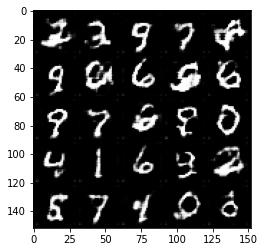

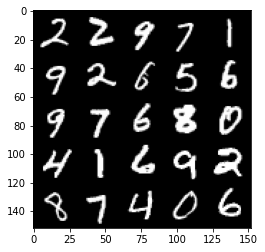

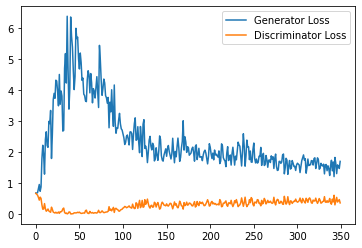

Step 7500: Generator loss: 1.4594941140413284, discriminator loss: 0.45569796669483187


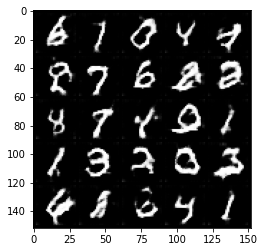

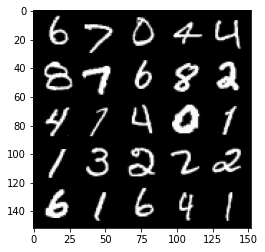

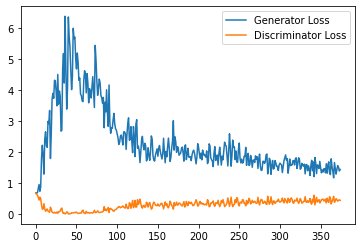

Step 8000: Generator loss: 1.5109740575551986, discriminator loss: 0.47511711275577545


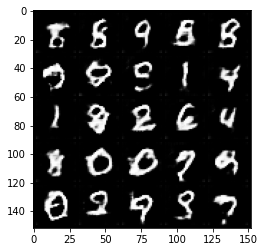

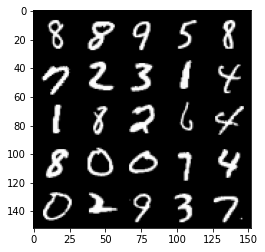

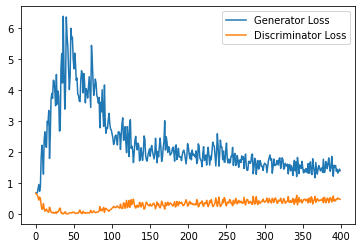

Step 8500: Generator loss: 1.392979868888855, discriminator loss: 0.48170998132228854


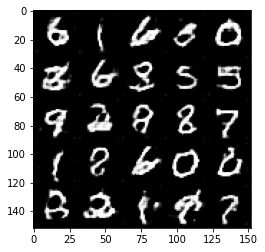

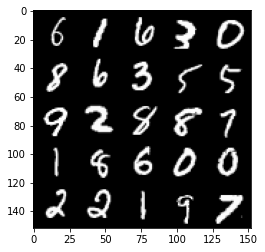

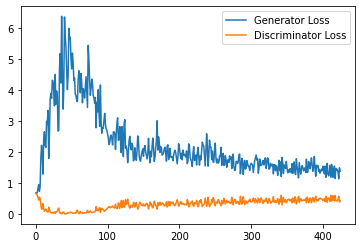

Step 9000: Generator loss: 1.3632745214700699, discriminator loss: 0.48702295404672624


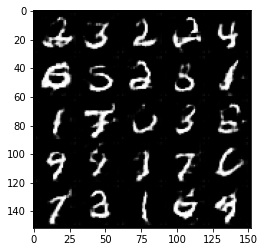

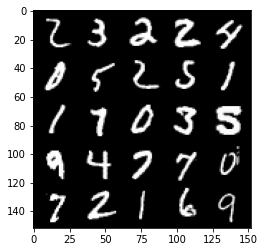

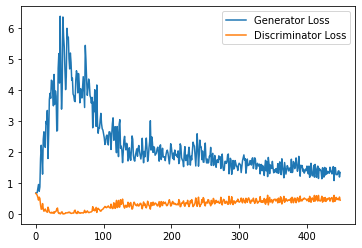

Step 9500: Generator loss: 1.3925407713651656, discriminator loss: 0.49415279215574265


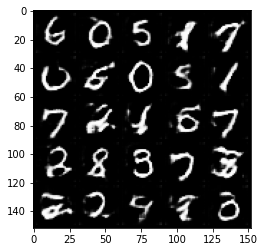

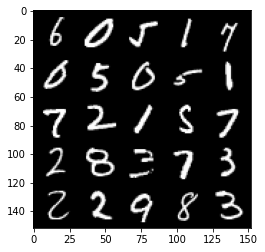

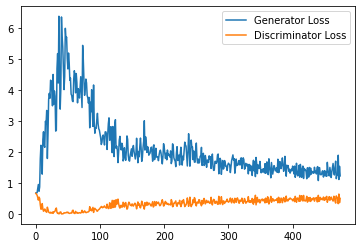

Step 10000: Generator loss: 1.2984486193656921, discriminator loss: 0.5138226307034492


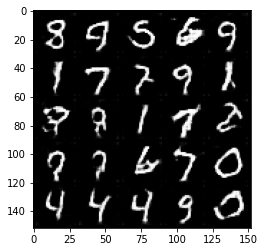

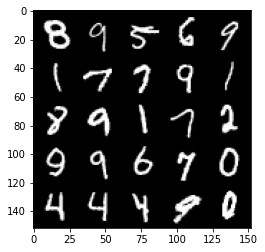

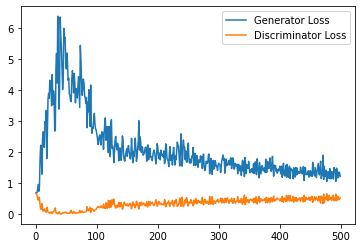

Step 10500: Generator loss: 1.2734157485961914, discriminator loss: 0.5199836313128471


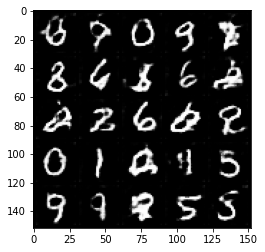

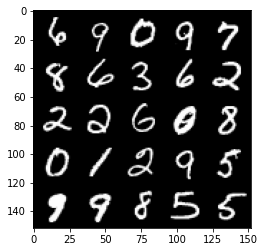

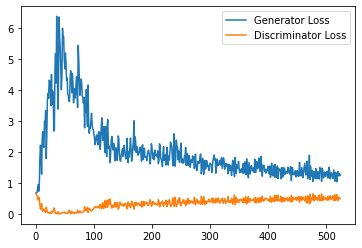

Step 11000: Generator loss: 1.2544166740179061, discriminator loss: 0.5230510792732239


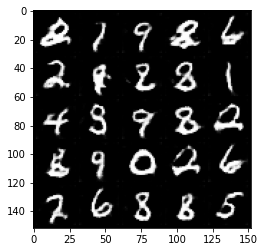

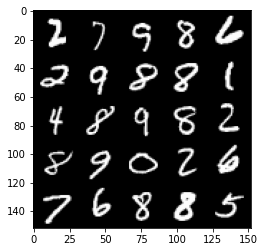

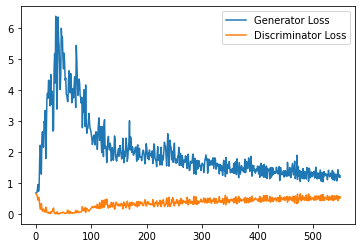

Step 11500: Generator loss: 1.2184739050865174, discriminator loss: 0.5371387383937836


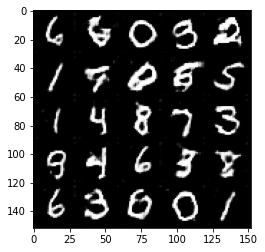

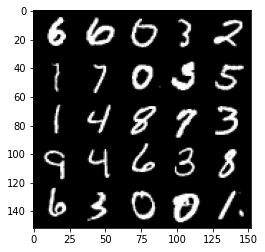

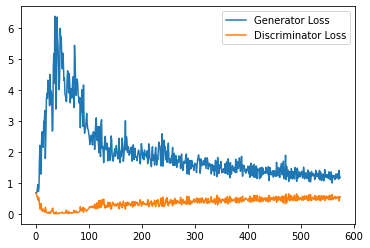

Step 12000: Generator loss: 1.2444206020832063, discriminator loss: 0.5304054528474808


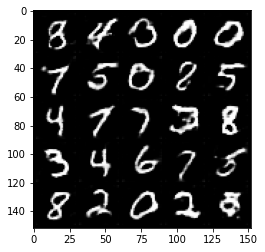

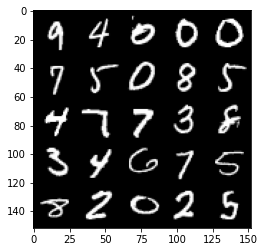

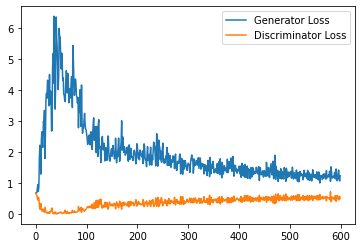

Step 12500: Generator loss: 1.2275047546625137, discriminator loss: 0.5432987669110299


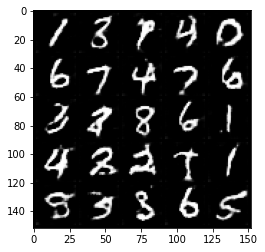

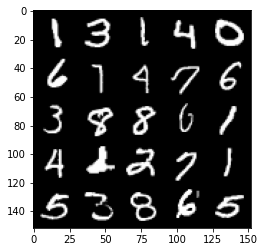

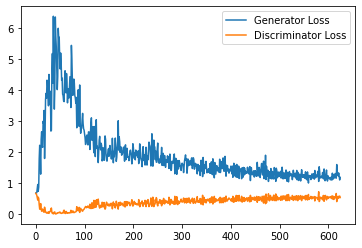

Step 13000: Generator loss: 1.2013075594902038, discriminator loss: 0.5482213507890701


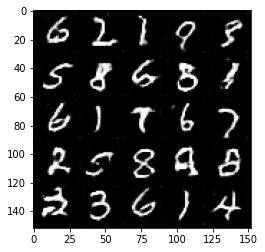

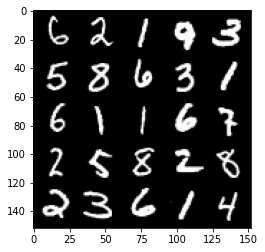

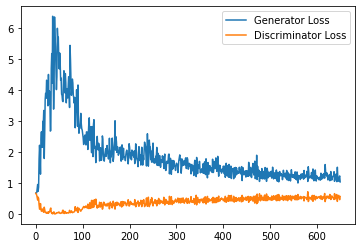

Step 13500: Generator loss: 1.1450323464870453, discriminator loss: 0.5534575121998787


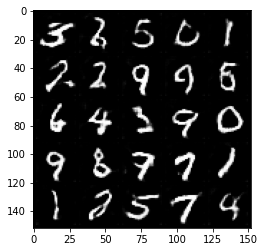

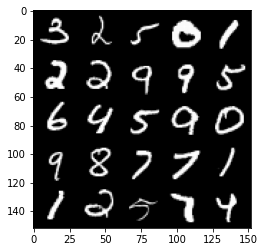

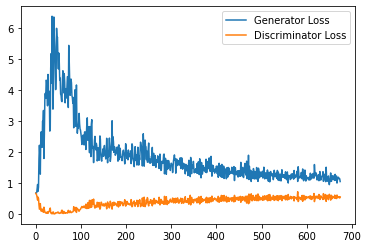

Step 14000: Generator loss: 1.1380952109098434, discriminator loss: 0.5595088735818863


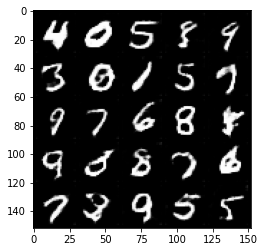

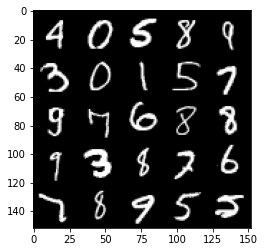

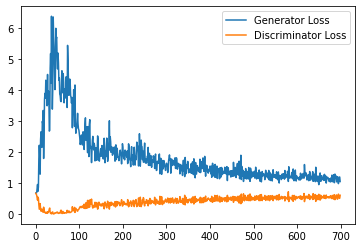

Step 14500: Generator loss: 1.1383216128349305, discriminator loss: 0.5555955926179886


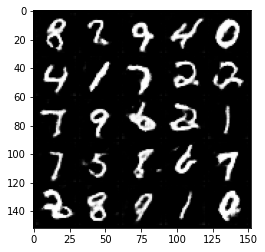

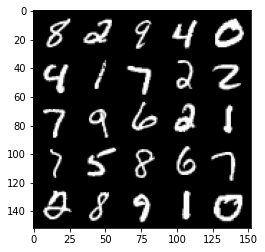

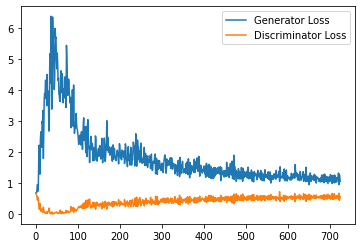

Step 15000: Generator loss: 1.1455120111703874, discriminator loss: 0.5631295084357262


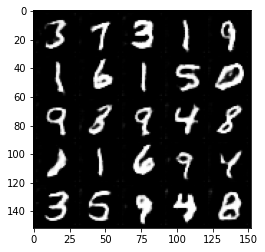

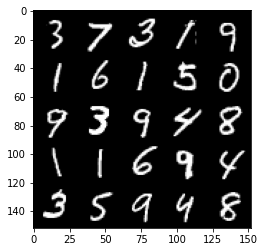

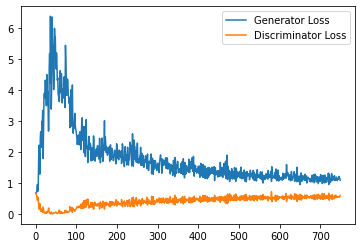

Step 15500: Generator loss: 1.1717917016744615, discriminator loss: 0.5673711296916008


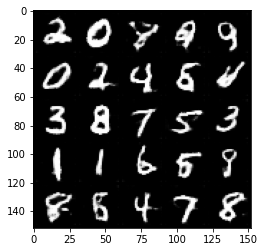

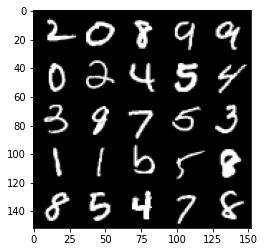

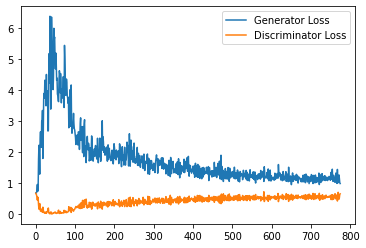

Step 16000: Generator loss: 1.1380872831344604, discriminator loss: 0.5547227375507354


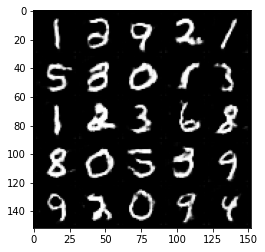

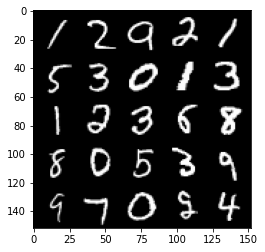

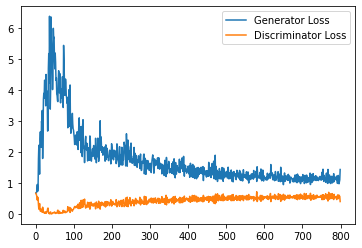

Step 16500: Generator loss: 1.1064732278585434, discriminator loss: 0.5708123004436493


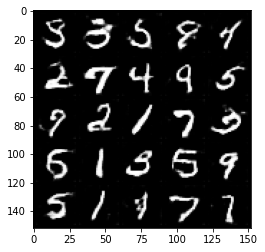

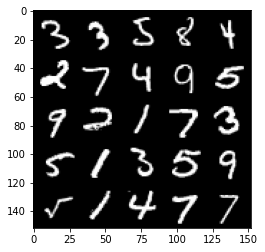

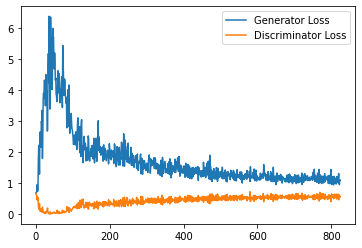

Step 17000: Generator loss: 1.1177042973041535, discriminator loss: 0.5661810950636864


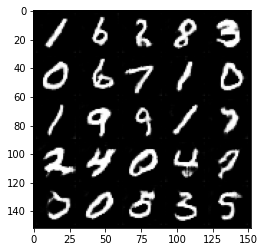

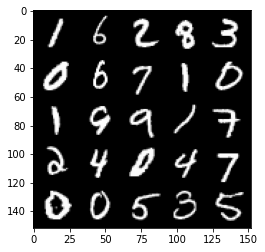

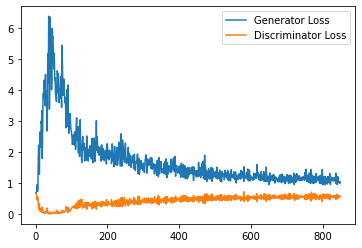

Step 17500: Generator loss: 1.0847735648155212, discriminator loss: 0.571785049021244


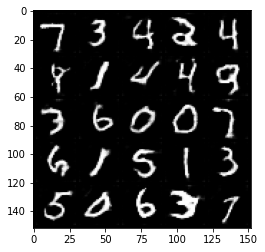

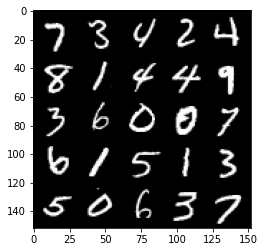

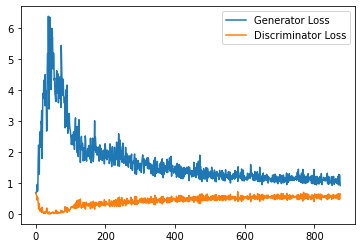

Step 18000: Generator loss: 1.0755053352117538, discriminator loss: 0.5727856975793838


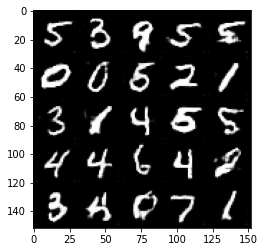

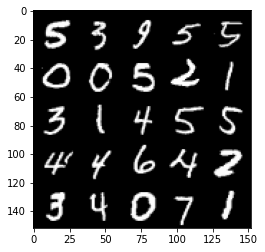

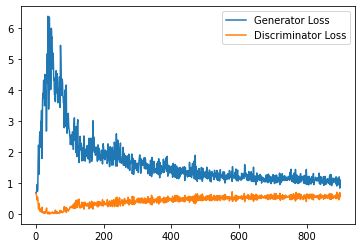

Step 18500: Generator loss: 1.0897195664644241, discriminator loss: 0.5749020966887474


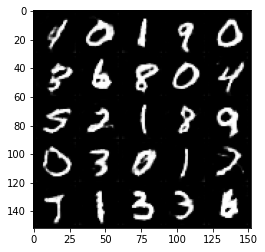

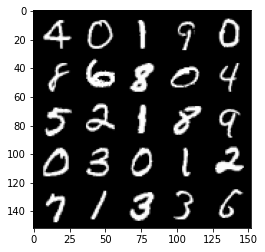

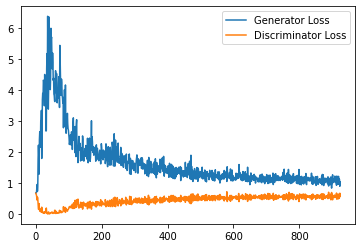

Step 19000: Generator loss: 1.0775180150270462, discriminator loss: 0.5766602150201797


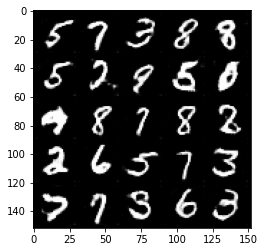

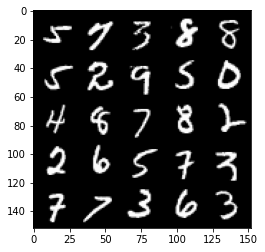

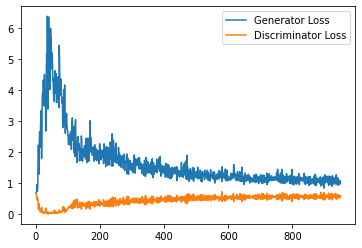

Step 19500: Generator loss: 1.050333323121071, discriminator loss: 0.5713418848514557


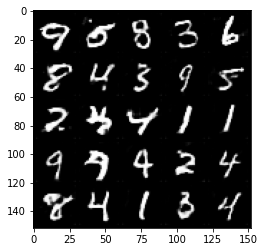

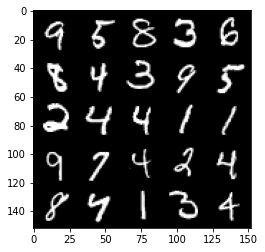

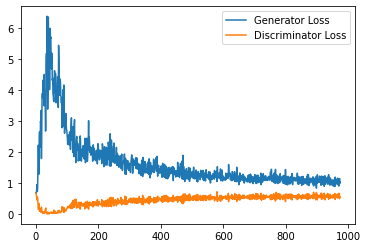

Step 20000: Generator loss: 1.0492955211400985, discriminator loss: 0.5796812092065811


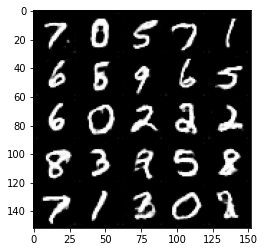

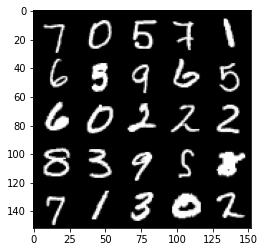

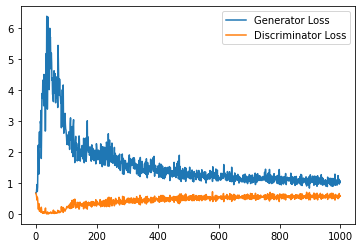

Step 20500: Generator loss: 1.0524024345874787, discriminator loss: 0.5783576893806458


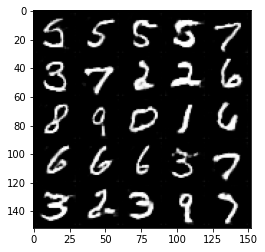

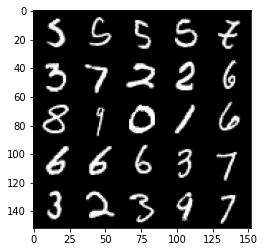

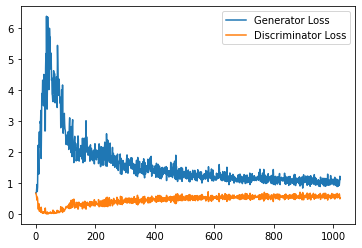

Step 21000: Generator loss: 1.0677099820375442, discriminator loss: 0.5860621877908707


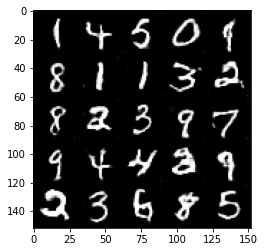

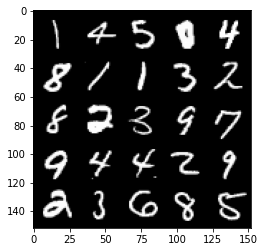

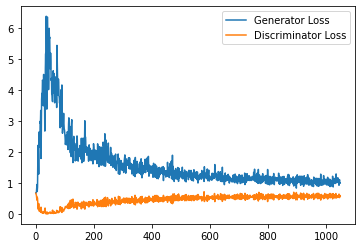

Step 21500: Generator loss: 1.0427242468595506, discriminator loss: 0.5832242324352265


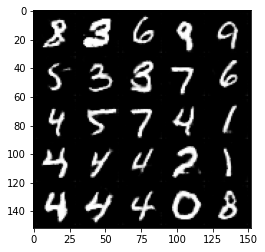

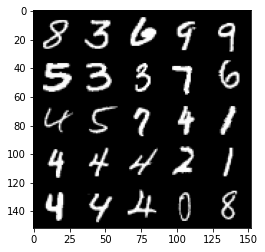

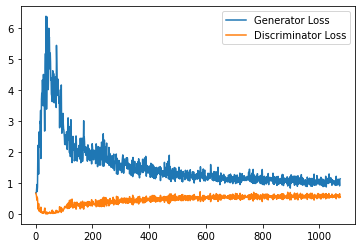

Step 22000: Generator loss: 1.0195844602584838, discriminator loss: 0.5917457597851753


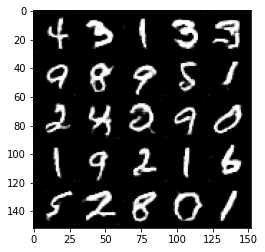

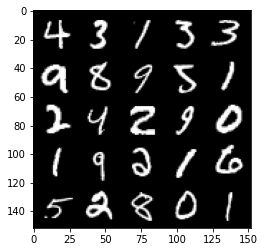

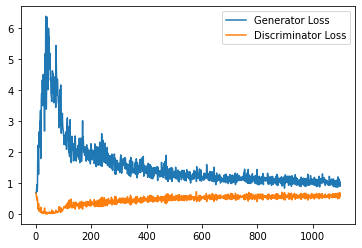

Step 22500: Generator loss: 1.018629722714424, discriminator loss: 0.5946000862717629


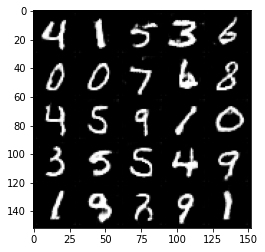

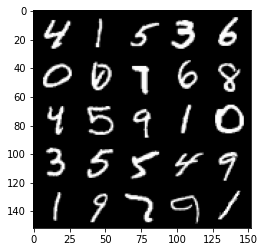

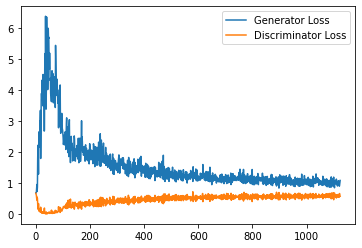

Step 23000: Generator loss: 1.0210314608812332, discriminator loss: 0.59135177141428


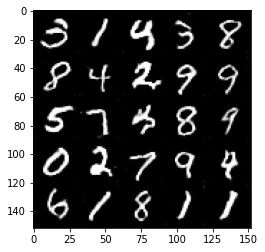

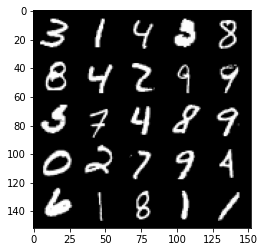

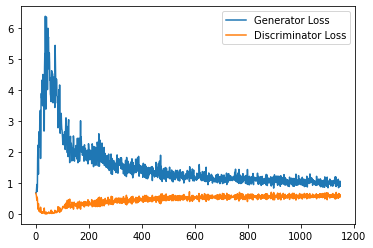

Step 23500: Generator loss: 0.9846178852319717, discriminator loss: 0.5962834226489067


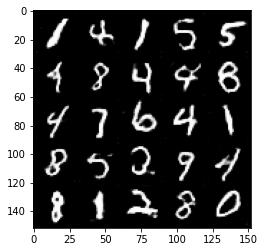

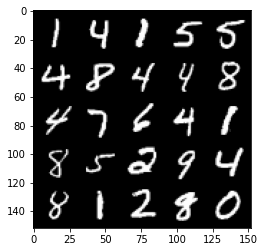

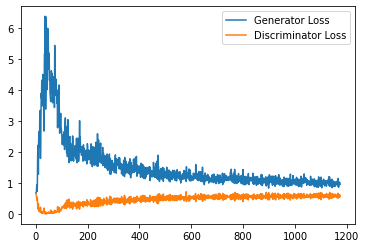

Step 24000: Generator loss: 0.9922957904338837, discriminator loss: 0.5935848414301872


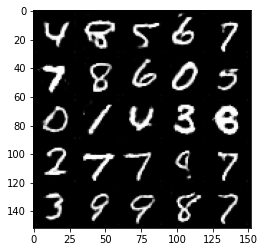

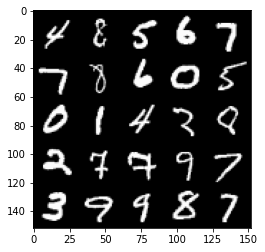

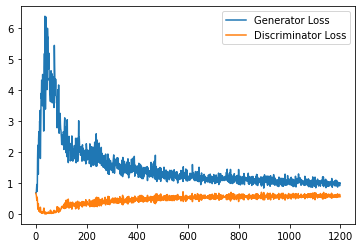

Step 24500: Generator loss: 1.015335438489914, discriminator loss: 0.5933528085947036


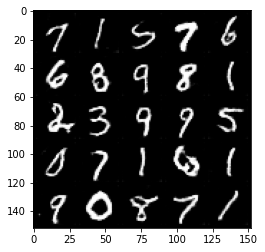

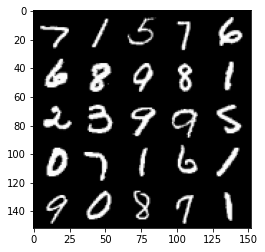

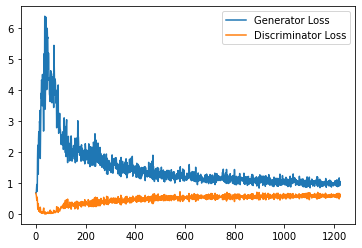

Step 25000: Generator loss: 1.0110011740922928, discriminator loss: 0.5894592877626419


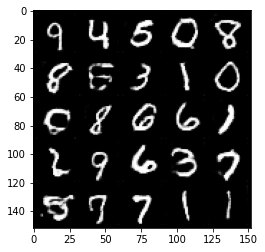

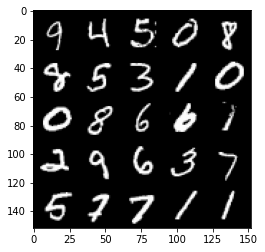

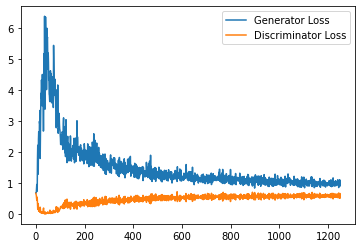

Step 25500: Generator loss: 1.0000795304775238, discriminator loss: 0.5917403857707977


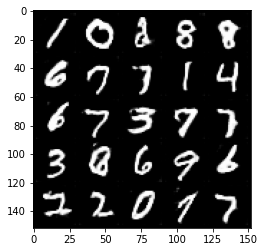

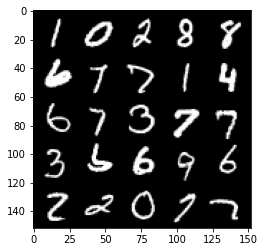

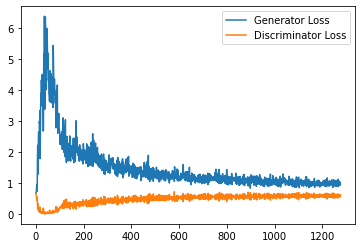

Step 26000: Generator loss: 0.9881551606655121, discriminator loss: 0.5978096579909324


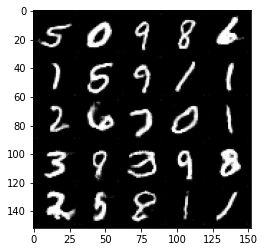

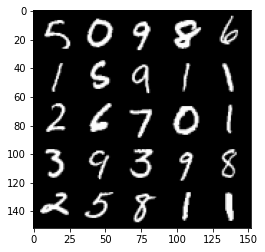

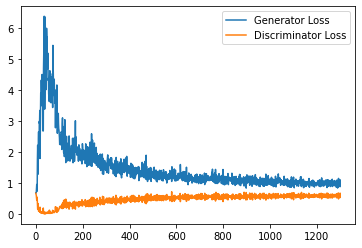

Step 26500: Generator loss: 1.0267672466039657, discriminator loss: 0.5969629229307175


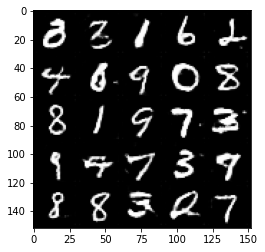

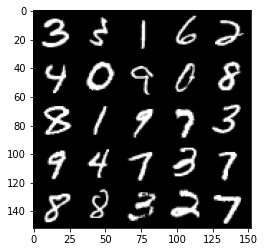

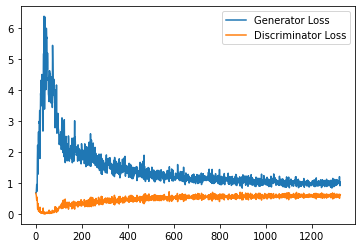

Step 27000: Generator loss: 1.0201921118497848, discriminator loss: 0.6009024724960327


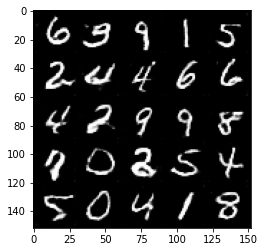

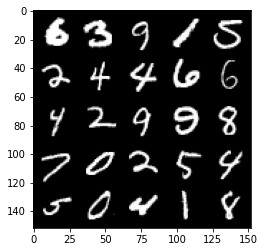

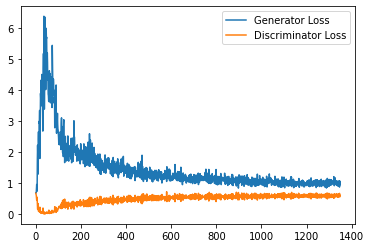

Step 27500: Generator loss: 1.0018973701000213, discriminator loss: 0.5993271228075028


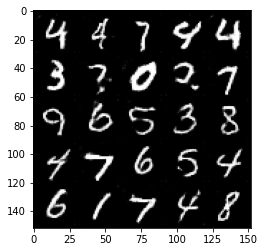

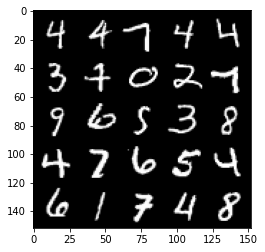

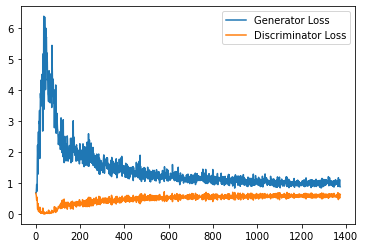

Step 28000: Generator loss: 1.0144581886529922, discriminator loss: 0.598627625465393


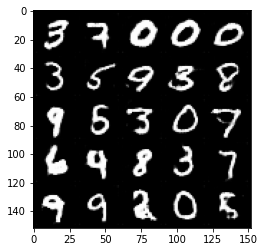

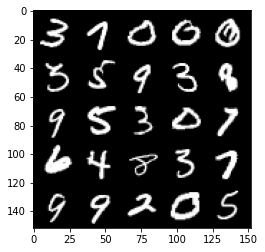

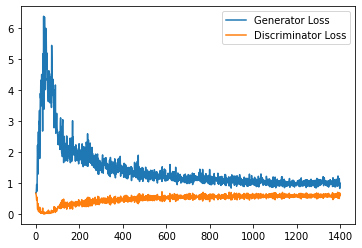

Step 28500: Generator loss: 0.9882249001264573, discriminator loss: 0.5969543044567108


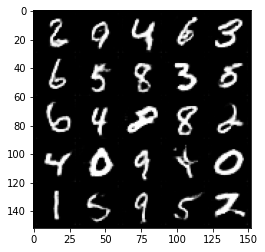

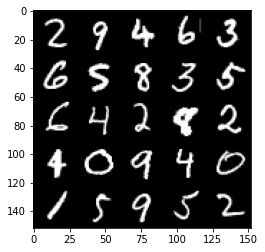

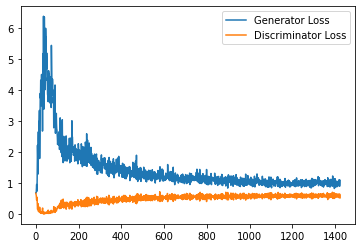

Step 29000: Generator loss: 1.0014236333370208, discriminator loss: 0.5992800629734993


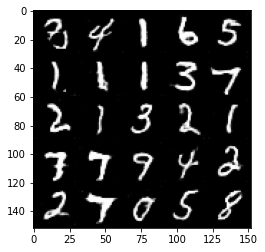

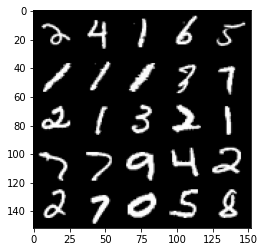

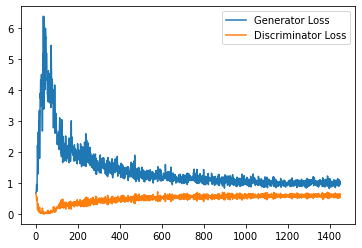

Step 29500: Generator loss: 0.9884327619075776, discriminator loss: 0.5976237187981606


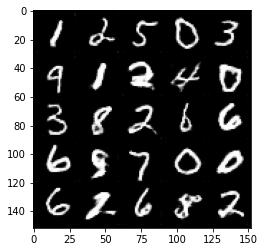

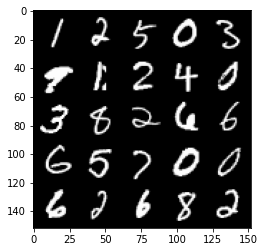

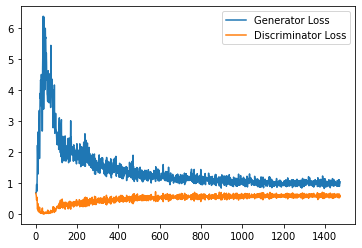

Step 30000: Generator loss: 0.9783208695650101, discriminator loss: 0.60285531270504


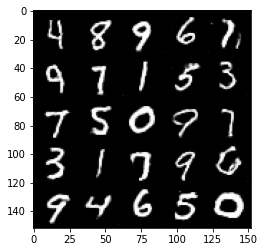

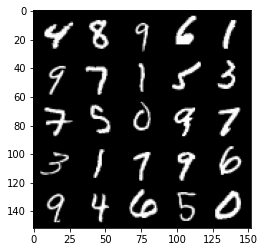

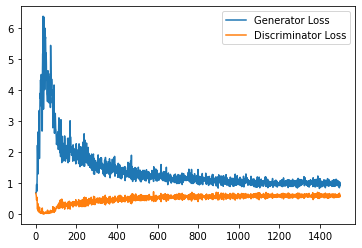

Step 30500: Generator loss: 0.9658156312704086, discriminator loss: 0.6068389696478844


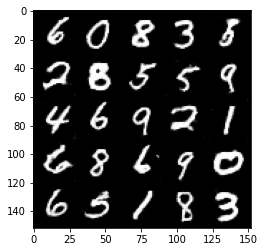

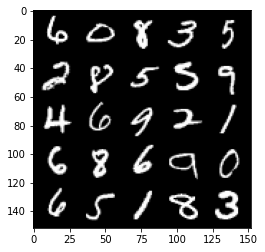

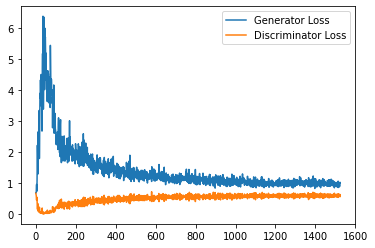

Step 31000: Generator loss: 0.9841844408512116, discriminator loss: 0.6036923753619194


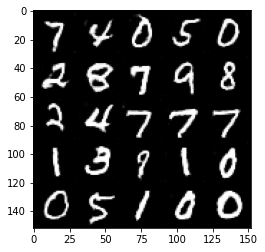

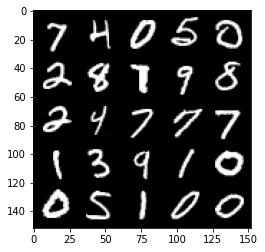

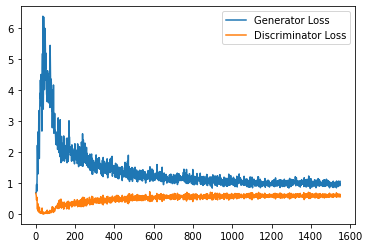

Step 31500: Generator loss: 1.0038837184906007, discriminator loss: 0.6029159187674522


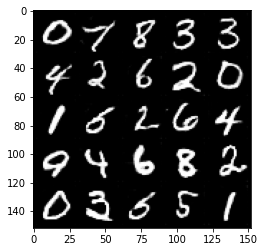

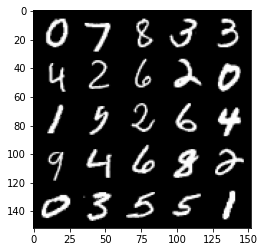

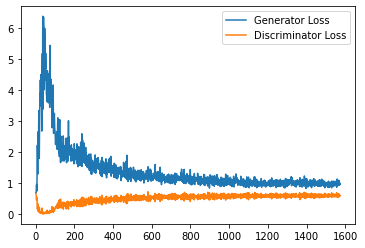

Step 32000: Generator loss: 0.9668606767654419, discriminator loss: 0.6048775064945221


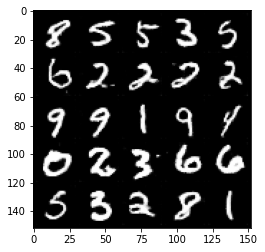

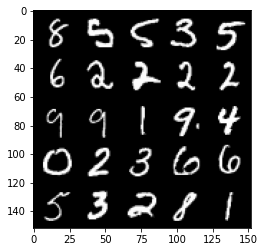

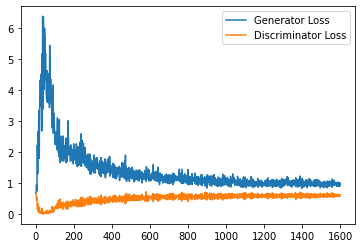

Step 32500: Generator loss: 0.9758483898639679, discriminator loss: 0.6046995445489883


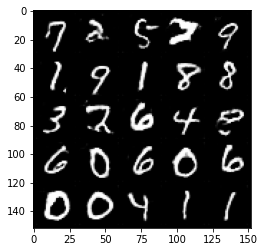

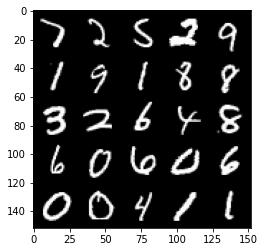

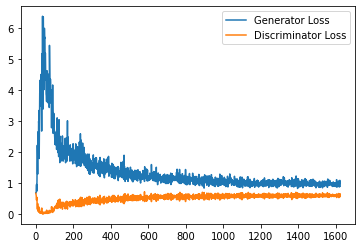

Step 33000: Generator loss: 0.9925536863803863, discriminator loss: 0.6038444039821624


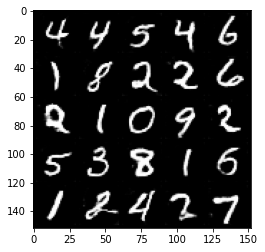

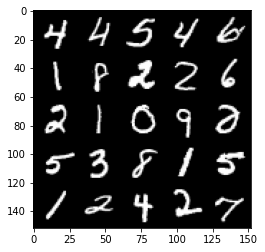

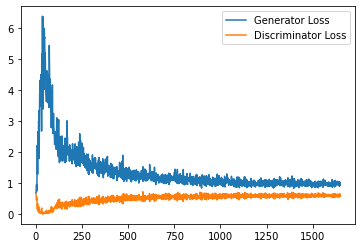

Step 33500: Generator loss: 0.981851243853569, discriminator loss: 0.601599945127964


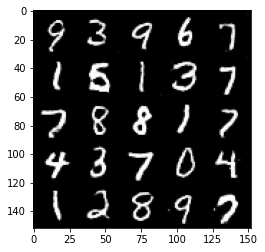

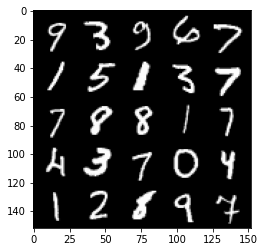

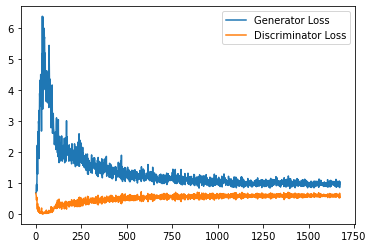

Step 34000: Generator loss: 0.9855987170934677, discriminator loss: 0.6083856034874916


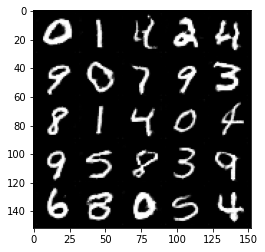

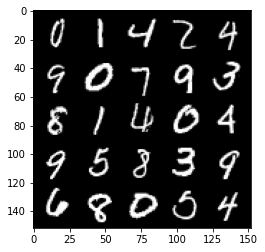

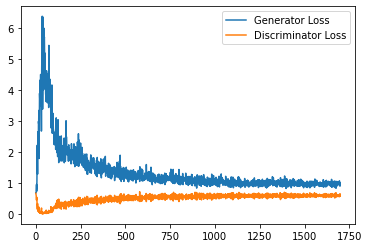

Step 34500: Generator loss: 0.9849269711971282, discriminator loss: 0.6043500178456307


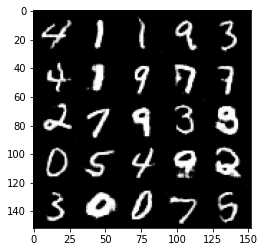

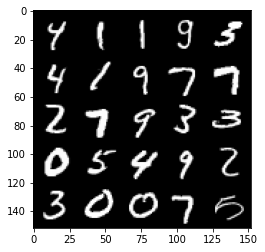

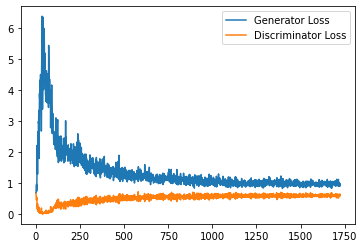

Step 35000: Generator loss: 0.9774180290699005, discriminator loss: 0.6003744729161262


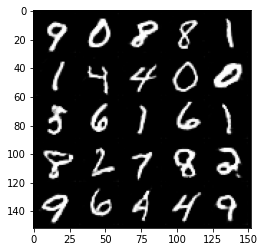

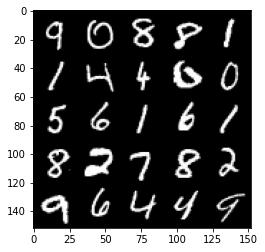

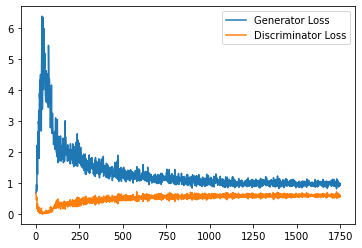

Step 35500: Generator loss: 0.953025734424591, discriminator loss: 0.6070503533482552


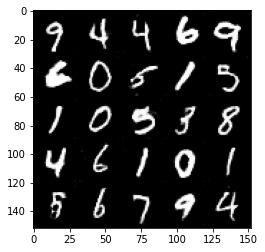

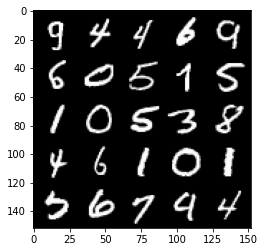

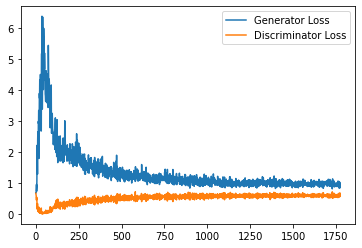

Step 36000: Generator loss: 0.9689055947065354, discriminator loss: 0.5998688051700592


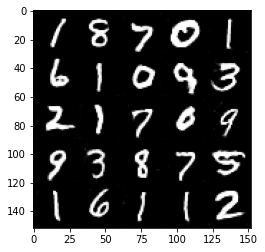

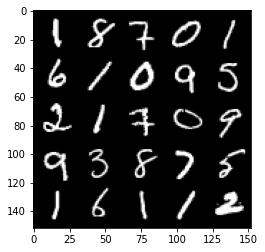

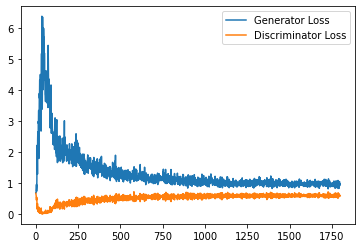

Step 36500: Generator loss: 0.9671847047805786, discriminator loss: 0.6048273980021477


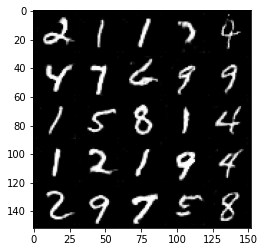

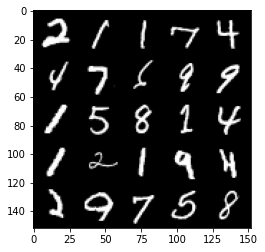

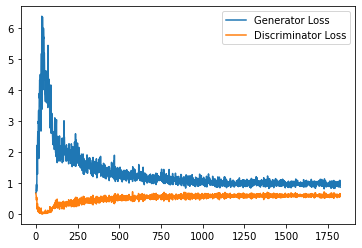

Step 37000: Generator loss: 0.9653017630577088, discriminator loss: 0.5997391892075539


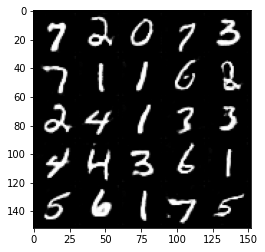

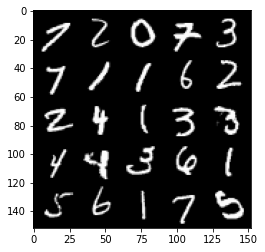

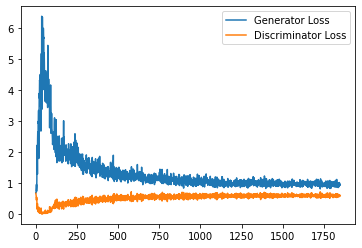

Step 37500: Generator loss: 0.9722087364196778, discriminator loss: 0.6029999850392341


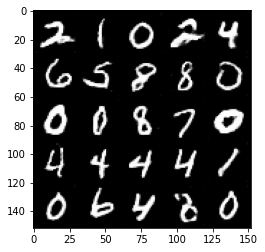

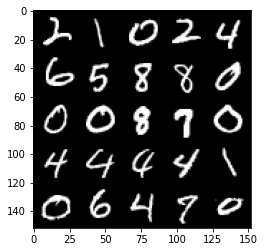

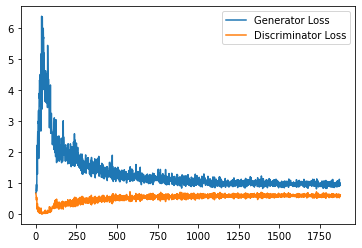

Step 38000: Generator loss: 0.9907321984767914, discriminator loss: 0.6020735570788384


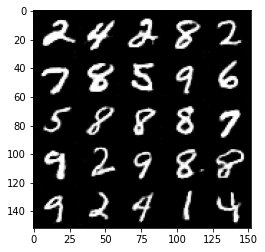

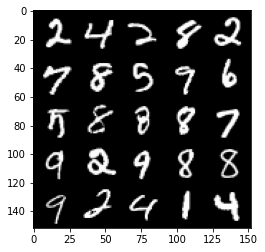

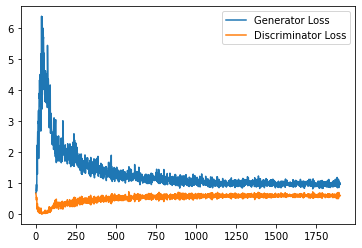

Step 38500: Generator loss: 0.9650479062795639, discriminator loss: 0.6048695515394211


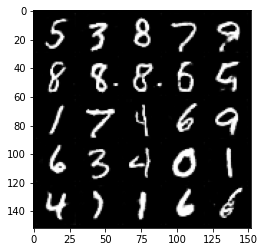

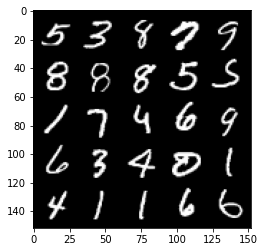

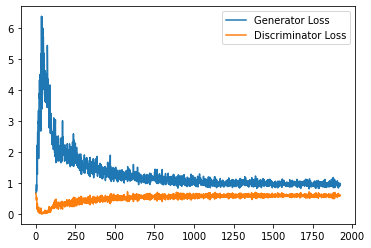

Step 39000: Generator loss: 0.9600529776811599, discriminator loss: 0.5984972911477089


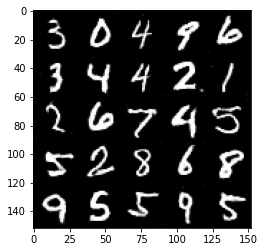

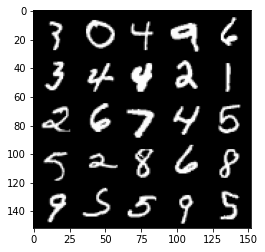

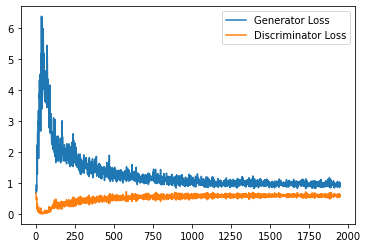

Step 39500: Generator loss: 0.9661661174297332, discriminator loss: 0.6022513439655304


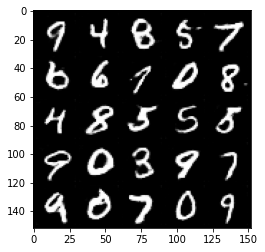

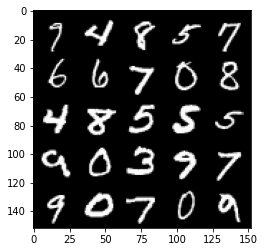

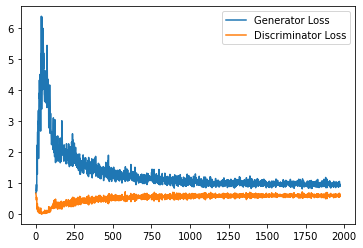

Step 40000: Generator loss: 0.9771272321939468, discriminator loss: 0.5990127394199372


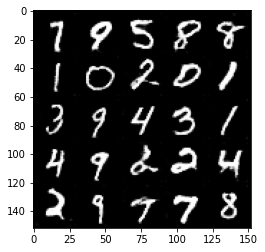

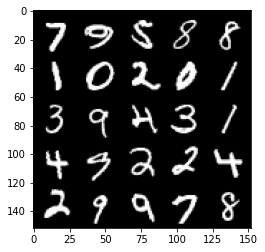

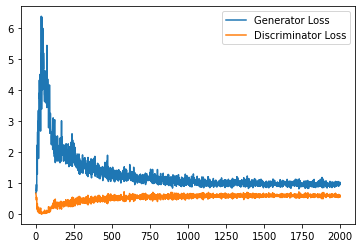

Step 40500: Generator loss: 0.9941369434595108, discriminator loss: 0.6010313131809235


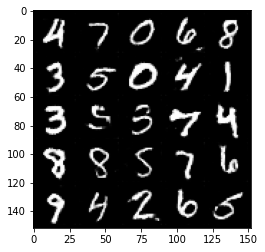

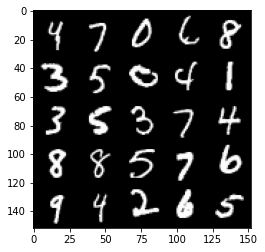

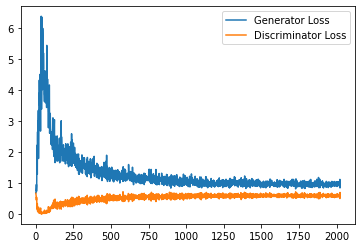

Step 41000: Generator loss: 0.9856043175458908, discriminator loss: 0.596251084446907


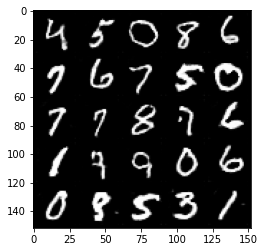

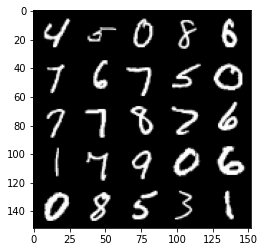

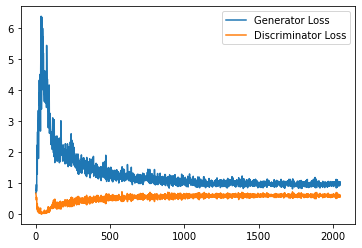

Step 41500: Generator loss: 0.9632399657964706, discriminator loss: 0.6001268807649612


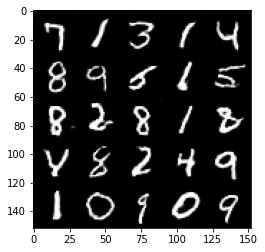

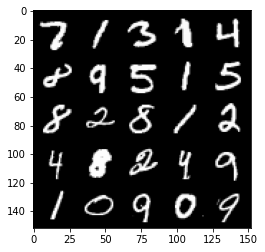

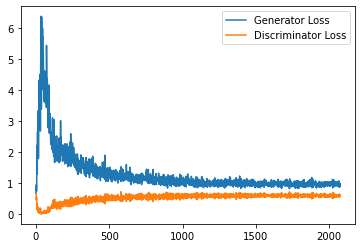

Step 42000: Generator loss: 1.0012573039531707, discriminator loss: 0.5954792058467865


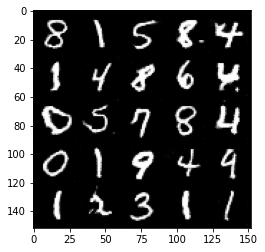

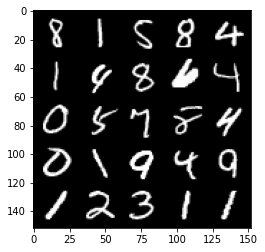

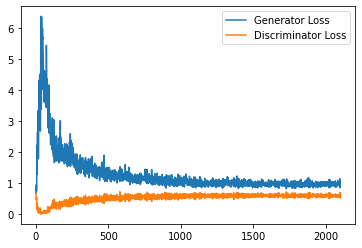

Step 42500: Generator loss: 0.9929103112220764, discriminator loss: 0.5967463449835777


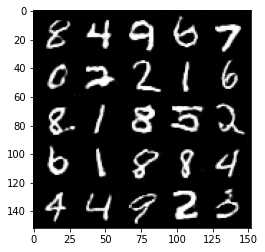

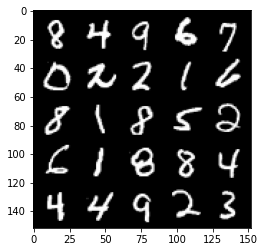

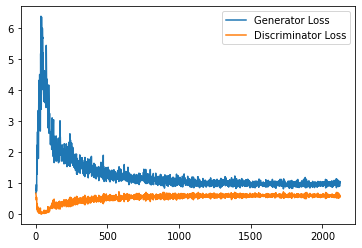

Step 43000: Generator loss: 0.9668361136913299, discriminator loss: 0.6000561456084251


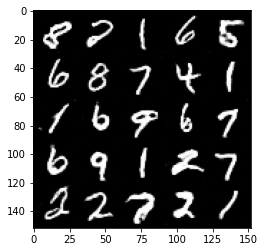

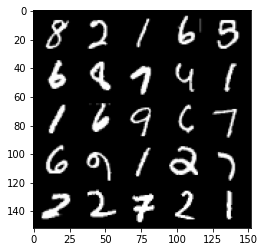

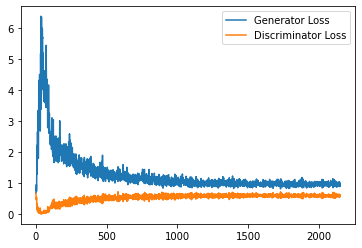

Step 43500: Generator loss: 0.9683649632930755, discriminator loss: 0.595654881298542


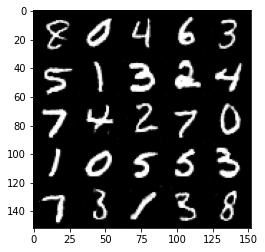

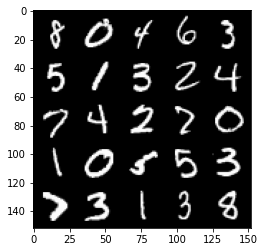

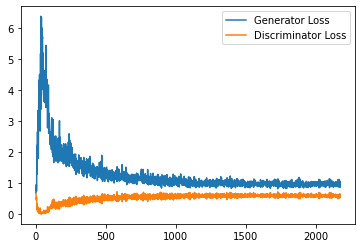

Step 44000: Generator loss: 0.9830452041625977, discriminator loss: 0.5961305298209191


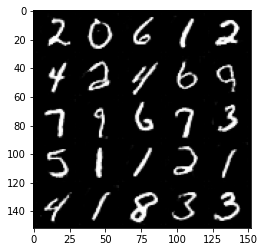

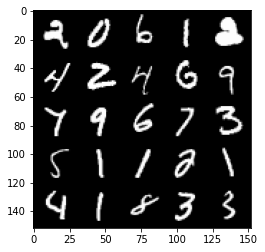

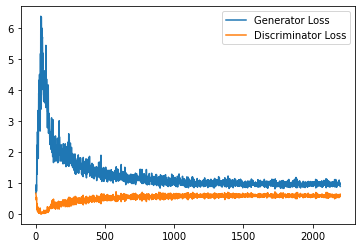

Step 44500: Generator loss: 0.9769629776477814, discriminator loss: 0.5945376717448234


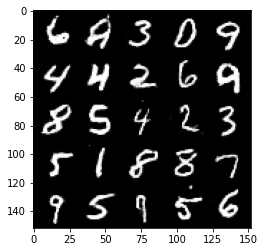

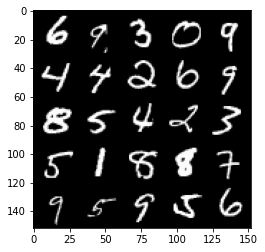

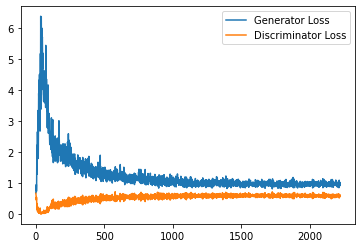

Step 45000: Generator loss: 0.9964579581022263, discriminator loss: 0.5932757930755616


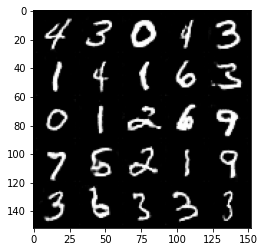

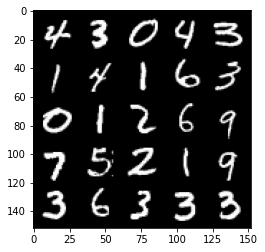

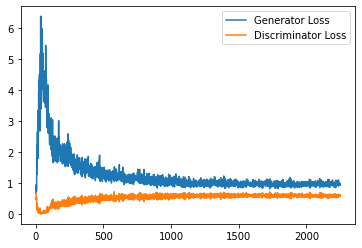

Step 45500: Generator loss: 0.9949724614620209, discriminator loss: 0.5966434487700463


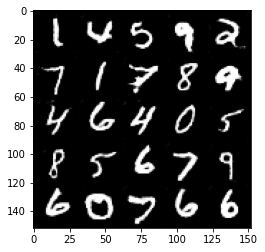

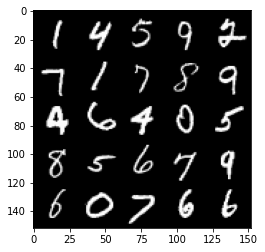

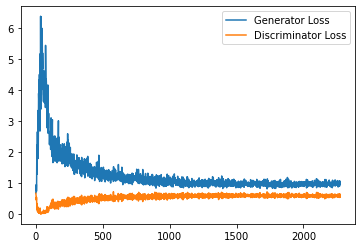

Step 46000: Generator loss: 0.9939384948015213, discriminator loss: 0.5959124670028687


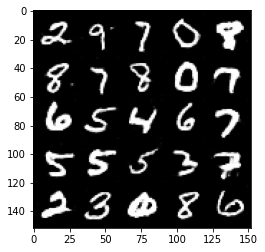

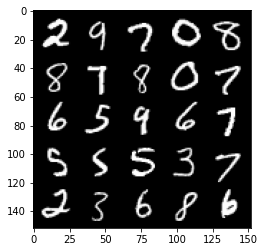

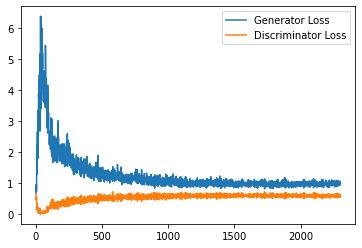

Step 46500: Generator loss: 0.9948169008493424, discriminator loss: 0.5890928713679313


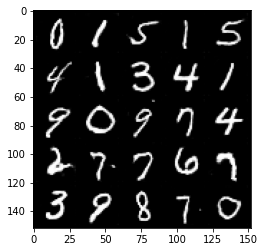

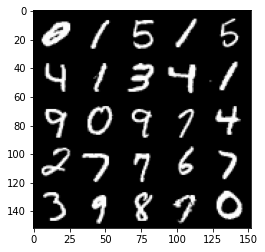

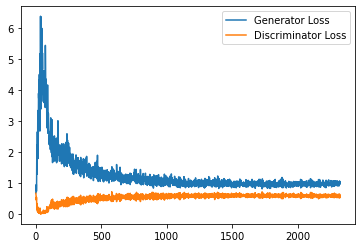

Step 47000: Generator loss: 0.9923898243904113, discriminator loss: 0.5930241144895554


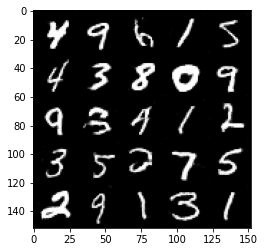

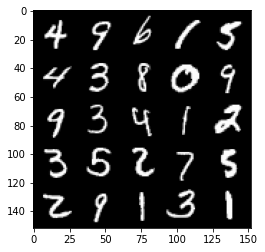

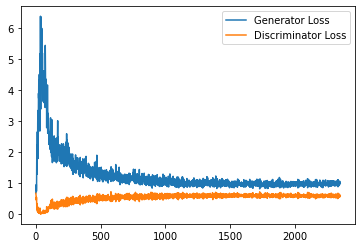

Step 47500: Generator loss: 1.0133532748222351, discriminator loss: 0.5980402435660362


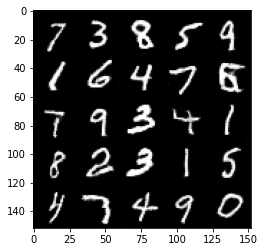

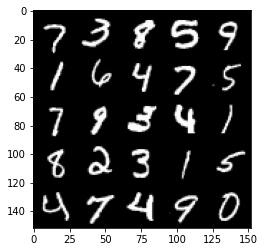

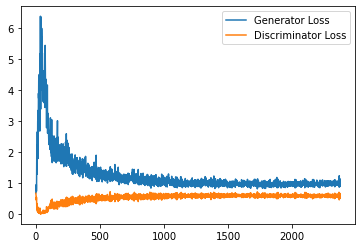

Step 48000: Generator loss: 0.998176943898201, discriminator loss: 0.5962998784780502


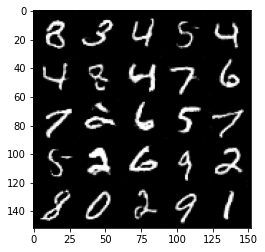

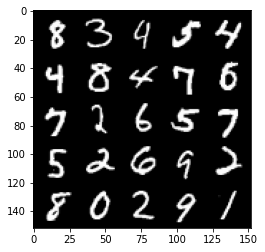

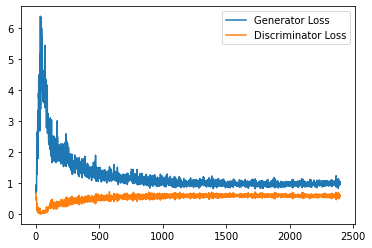

Step 48500: Generator loss: 0.9867133276462555, discriminator loss: 0.5921322914958


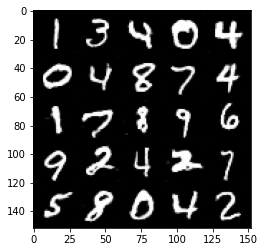

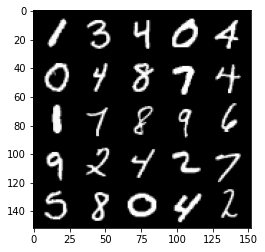

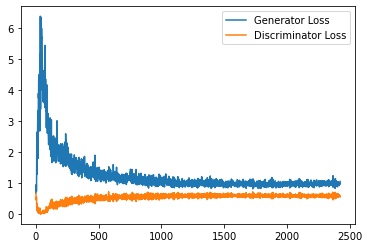

Step 49000: Generator loss: 0.9895061645507812, discriminator loss: 0.5872932832837104


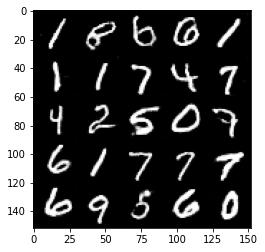

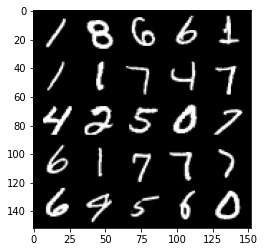

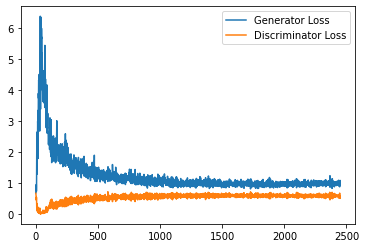

Step 49500: Generator loss: 1.0051772836446762, discriminator loss: 0.5952760836482048


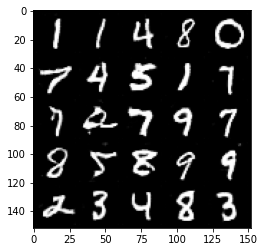

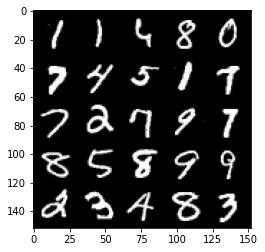

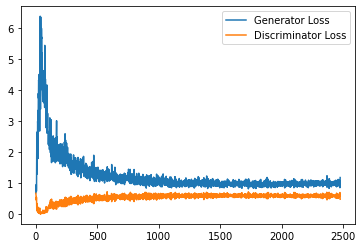

Step 50000: Generator loss: 0.99008229970932, discriminator loss: 0.5911907984018325


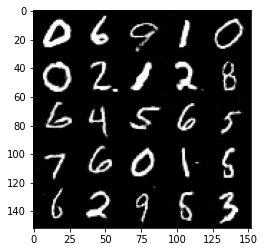

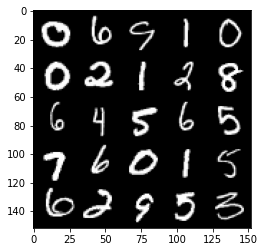

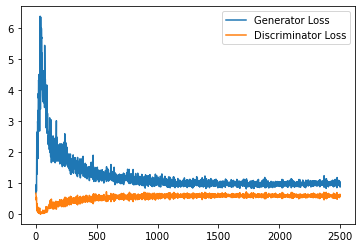

Step 50500: Generator loss: 0.9903393628597259, discriminator loss: 0.5933199294805527


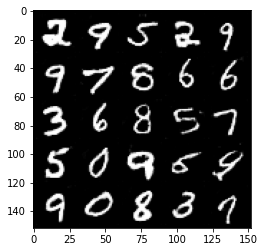

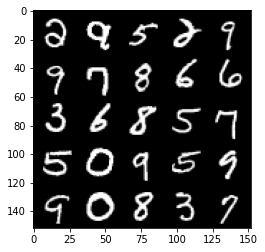

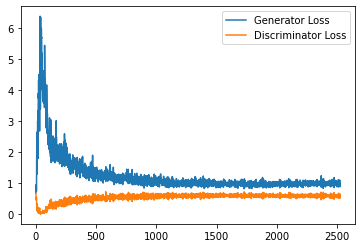

Step 51000: Generator loss: 0.9998241819143295, discriminator loss: 0.5853919664621353


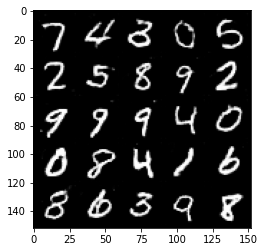

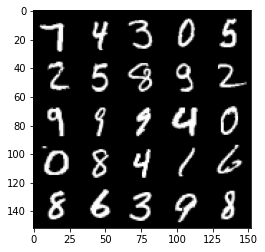

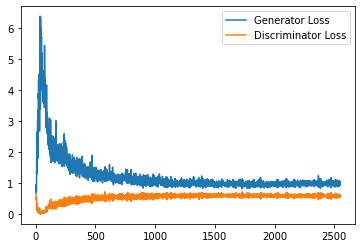

Step 51500: Generator loss: 1.0216618818044663, discriminator loss: 0.5840150572657585


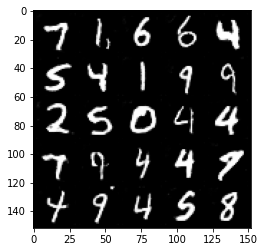

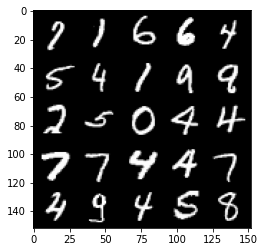

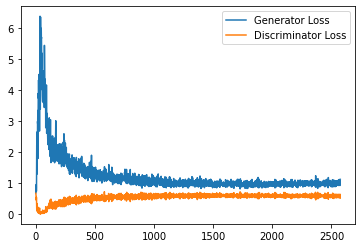

Step 52000: Generator loss: 1.0069632081985473, discriminator loss: 0.5903819953203201


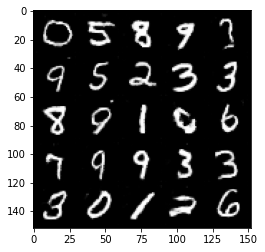

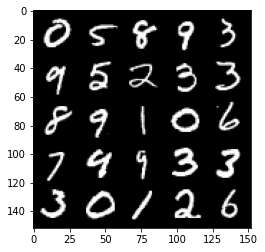

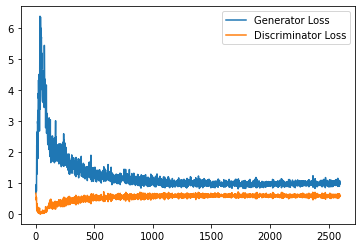

Step 52500: Generator loss: 1.0136210052967072, discriminator loss: 0.5909612709879876


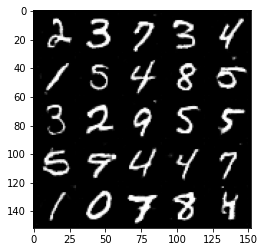

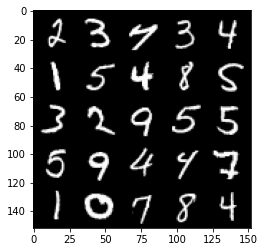

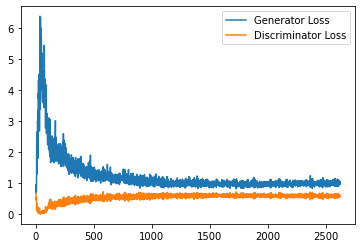

Step 53000: Generator loss: 0.9964404580593109, discriminator loss: 0.5832451009750366


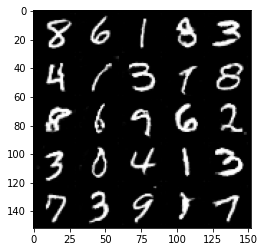

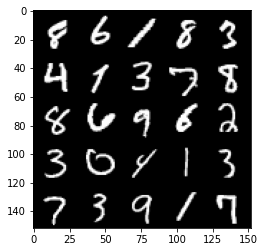

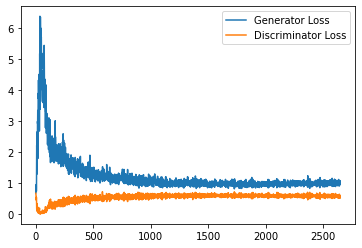

Step 53500: Generator loss: 0.9989690504074097, discriminator loss: 0.5827156705260277


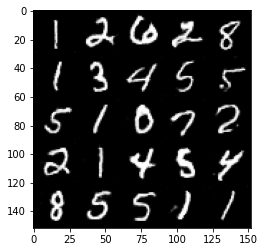

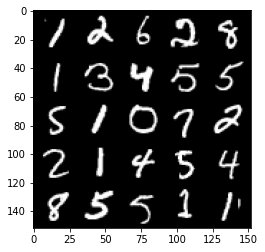

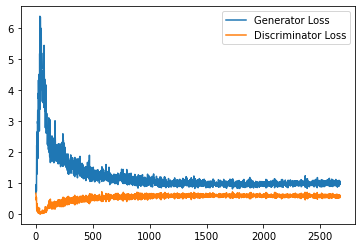

Step 54000: Generator loss: 1.0255954362154007, discriminator loss: 0.5807496745586396


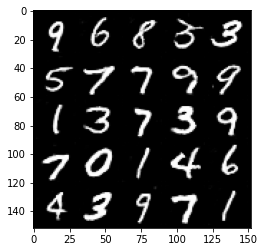

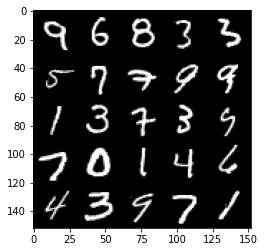

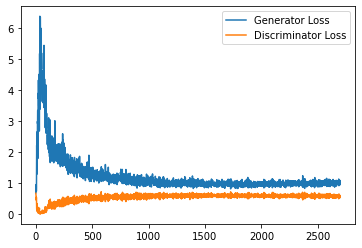

Step 54500: Generator loss: 1.0081332652568817, discriminator loss: 0.5843343992829323


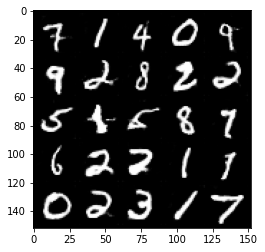

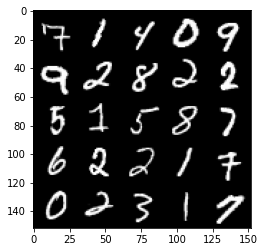

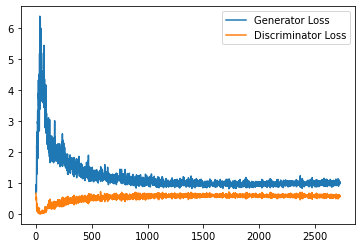

Step 55000: Generator loss: 1.0237853111028672, discriminator loss: 0.5795284491181374


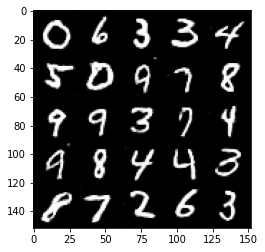

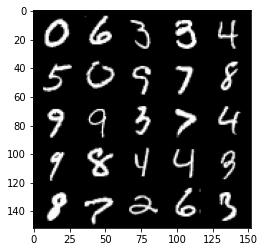

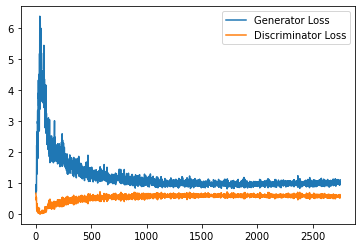

Step 55500: Generator loss: 1.023367936372757, discriminator loss: 0.5850880482792854


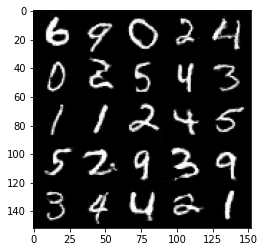

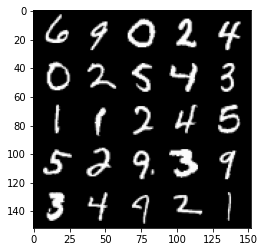

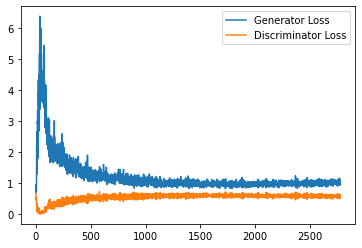

Step 56000: Generator loss: 1.043676677465439, discriminator loss: 0.5791077216267586


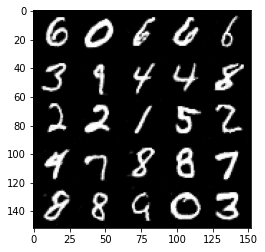

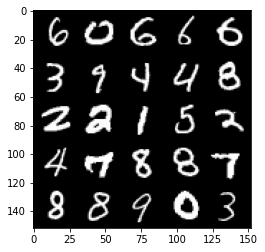

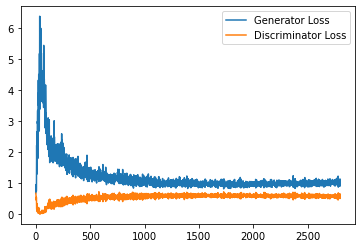

Step 56500: Generator loss: 1.0386683758497237, discriminator loss: 0.5814711878299713


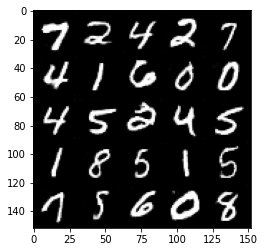

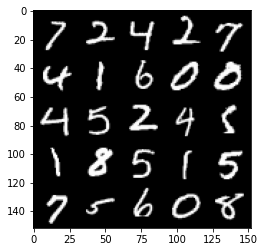

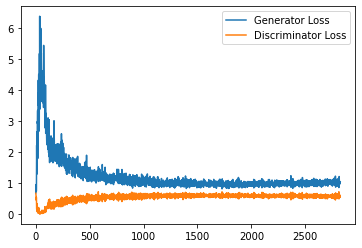

Step 57000: Generator loss: 1.0262535848617553, discriminator loss: 0.5785111877322197


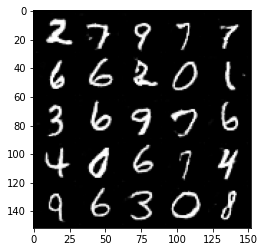

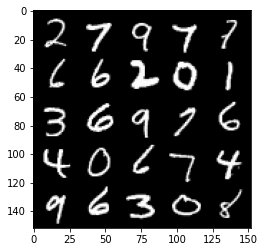

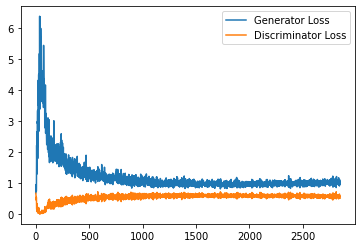

Step 57500: Generator loss: 1.0223006088733673, discriminator loss: 0.5759358863830566


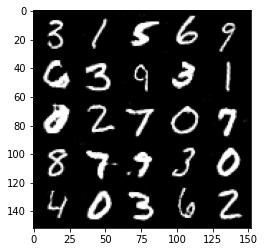

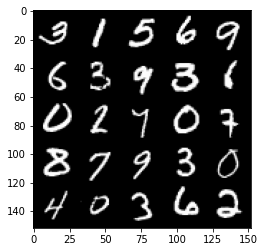

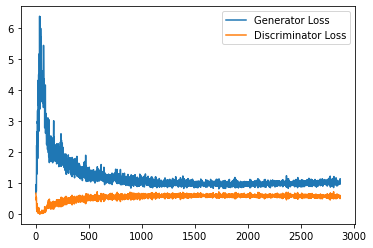

Step 58000: Generator loss: 1.0307991342544556, discriminator loss: 0.579774871468544


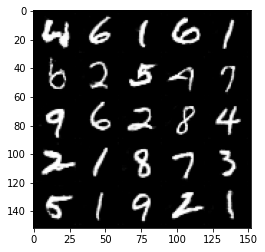

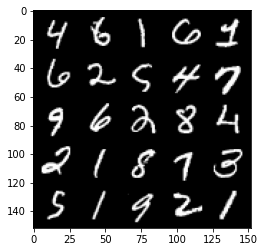

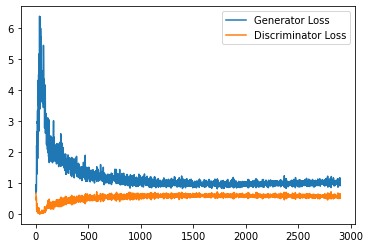

Step 58500: Generator loss: 1.0483902369737625, discriminator loss: 0.574648398578167


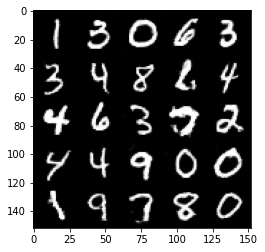

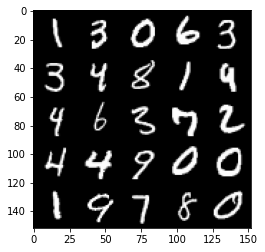

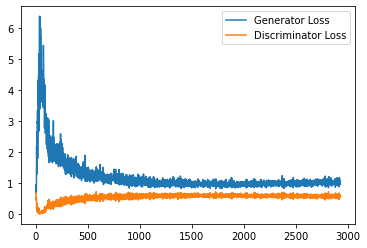

Step 59000: Generator loss: 1.0344476176500321, discriminator loss: 0.5813067286014557


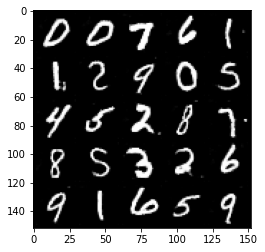

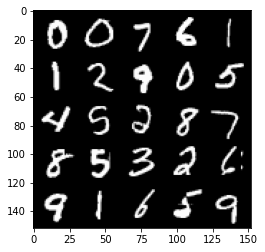

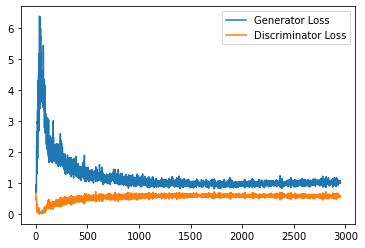

Step 59500: Generator loss: 1.0264677691459656, discriminator loss: 0.5811489401459694


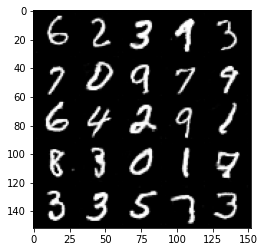

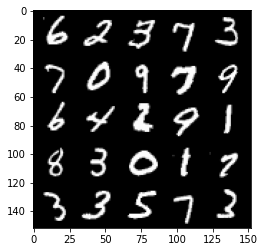

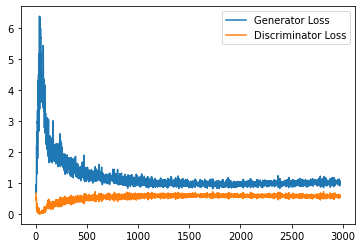

Step 60000: Generator loss: 1.0328279112577439, discriminator loss: 0.5739076098203659


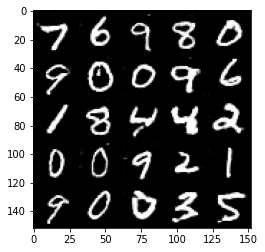

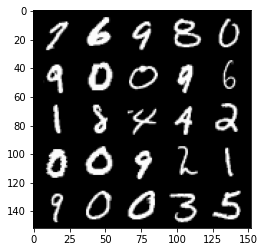

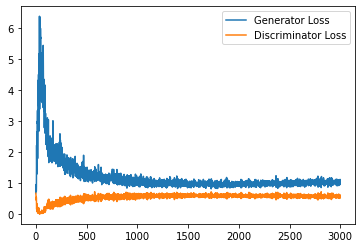

Step 60500: Generator loss: 1.0310646690130234, discriminator loss: 0.5797474793195725


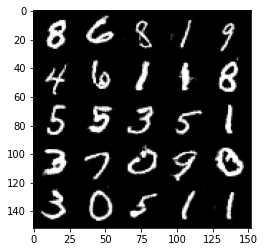

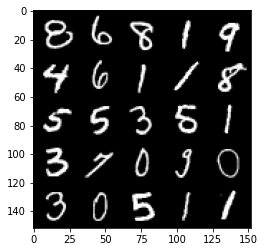

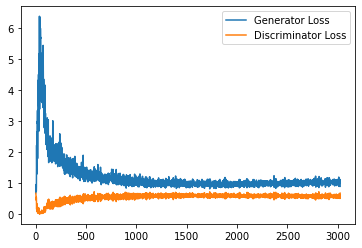

Step 61000: Generator loss: 1.0400475409030914, discriminator loss: 0.5767946489453316


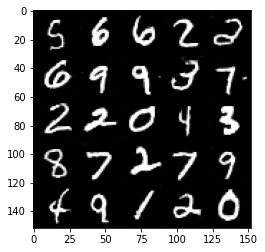

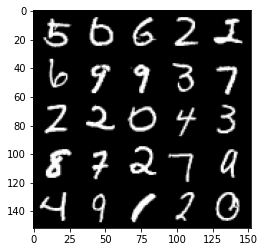

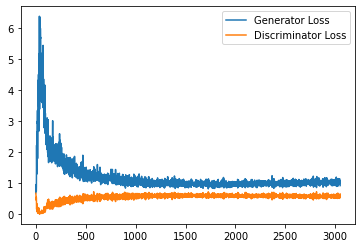

Step 61500: Generator loss: 1.050720340847969, discriminator loss: 0.5738650683760643


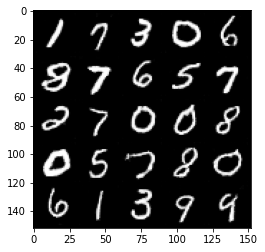

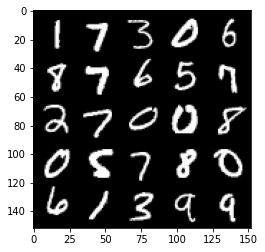

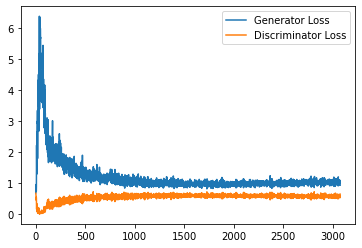

Step 62000: Generator loss: 1.0491667895317078, discriminator loss: 0.5722000920176507


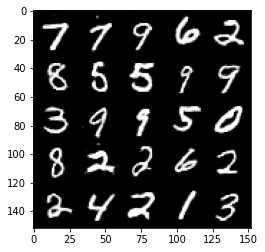

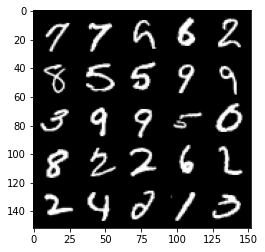

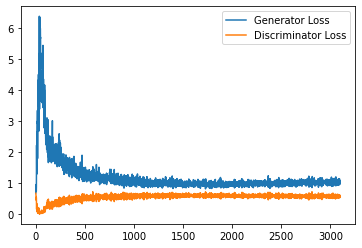

Step 62500: Generator loss: 1.0607322767972946, discriminator loss: 0.5755268504619598


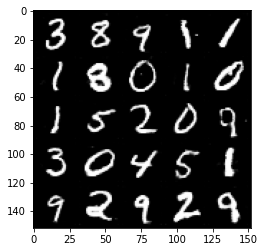

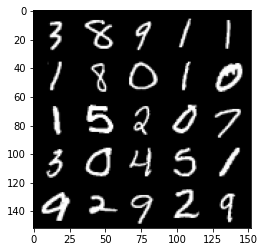

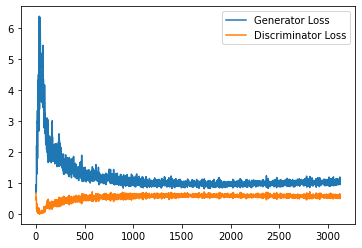

Step 63000: Generator loss: 1.0316791439056396, discriminator loss: 0.5773161593079567


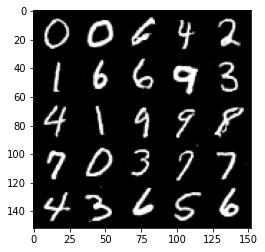

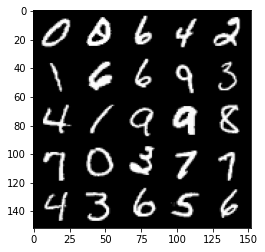

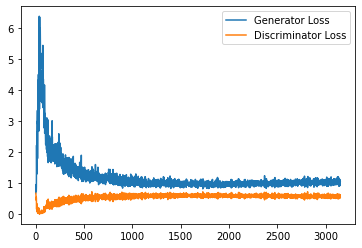

Step 63500: Generator loss: 1.0558549399375916, discriminator loss: 0.5684125748872757


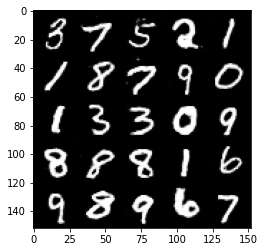

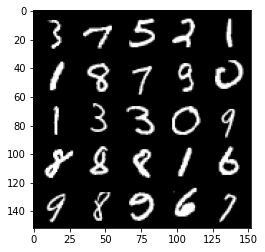

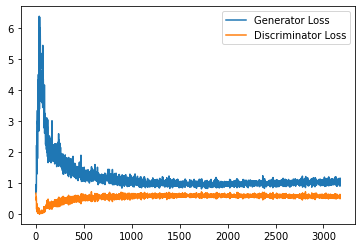

Step 64000: Generator loss: 1.0608536330461502, discriminator loss: 0.5702190668582916


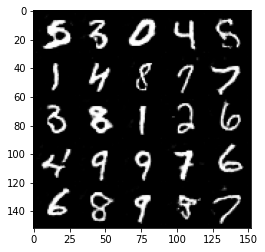

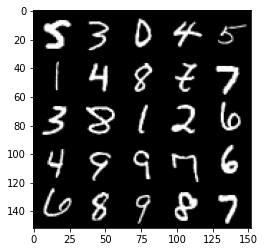

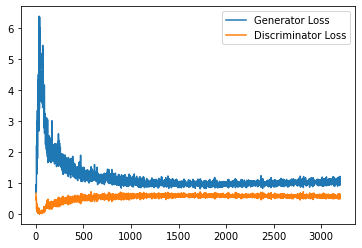

Step 64500: Generator loss: 1.060756306886673, discriminator loss: 0.5702837570905686


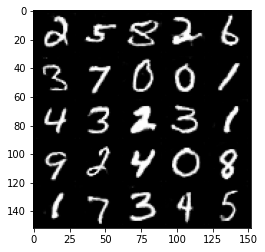

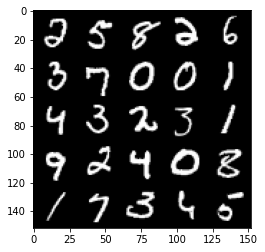

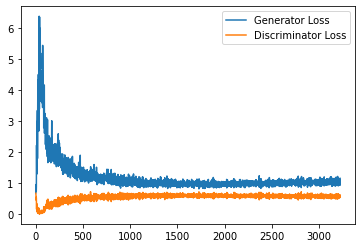

Step 65000: Generator loss: 1.0486057611703872, discriminator loss: 0.5764601094126701


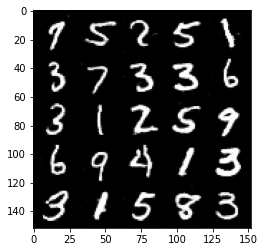

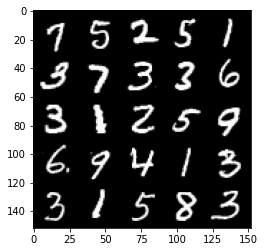

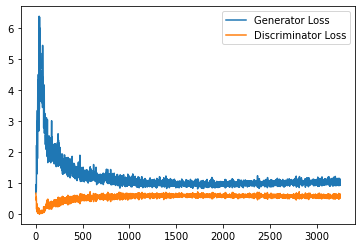

Step 65500: Generator loss: 1.0403061805963516, discriminator loss: 0.5658489195108414


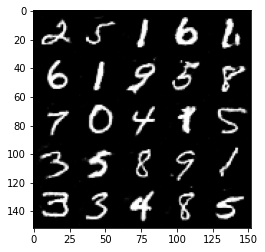

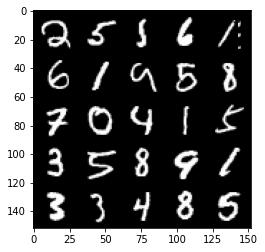

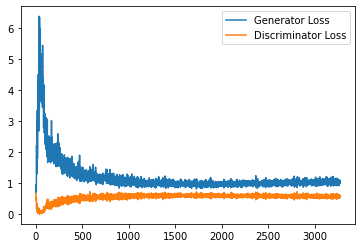

Step 66000: Generator loss: 1.0595869587659836, discriminator loss: 0.5659057422280311


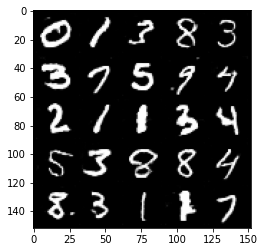

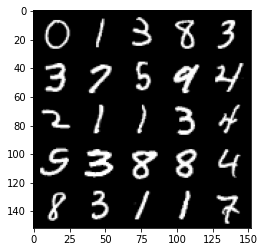

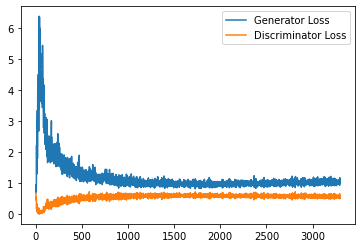

Step 66500: Generator loss: 1.0644469888210297, discriminator loss: 0.5694406108856201


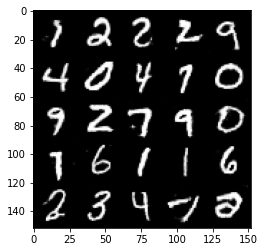

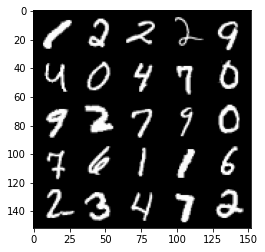

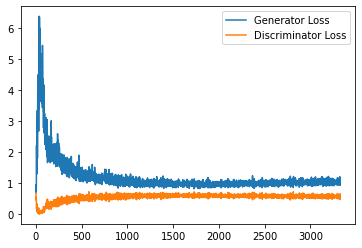

Step 67000: Generator loss: 1.064524325966835, discriminator loss: 0.5697863391041755


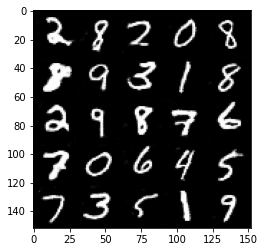

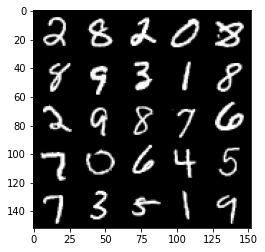

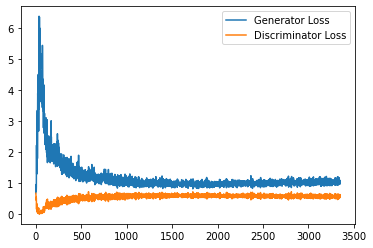

Step 67500: Generator loss: 1.072264726281166, discriminator loss: 0.5661609362959862


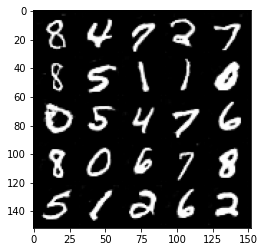

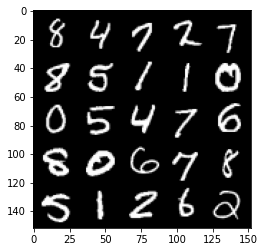

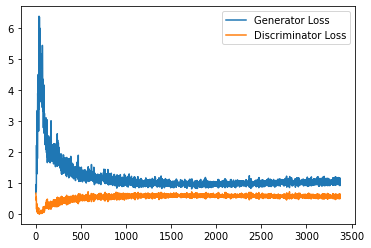

Step 68000: Generator loss: 1.0459704442024231, discriminator loss: 0.5659159142971039


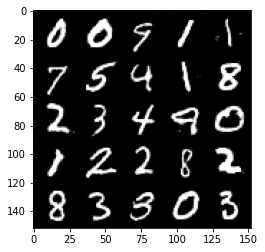

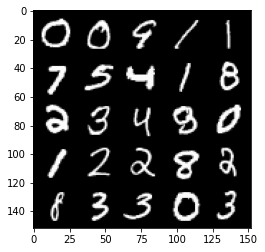

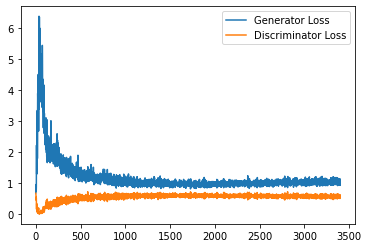

Step 68500: Generator loss: 1.0663988889455795, discriminator loss: 0.5625340801477432


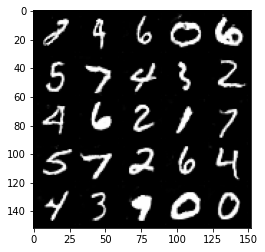

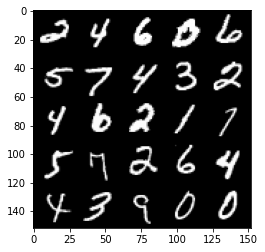

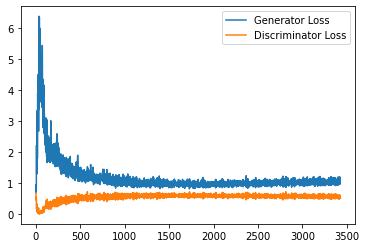

Step 69000: Generator loss: 1.0810299952030182, discriminator loss: 0.5587983972430229


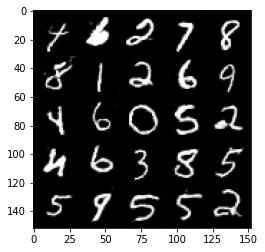

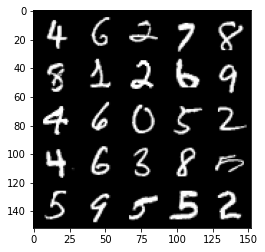

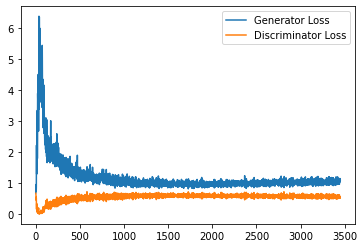

Step 69500: Generator loss: 1.0612946115732194, discriminator loss: 0.5653231008052826


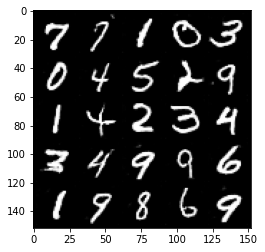

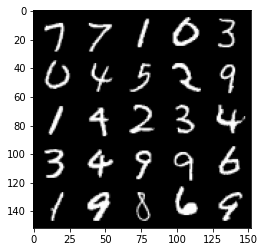

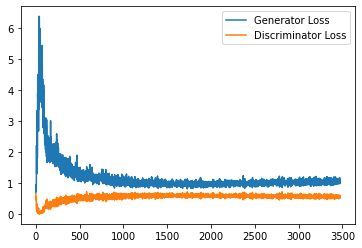

Step 70000: Generator loss: 1.075301330089569, discriminator loss: 0.5616116037964821


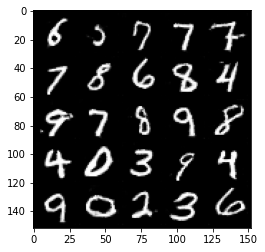

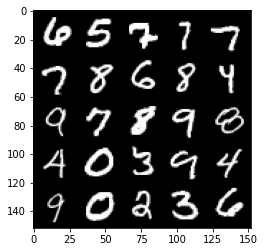

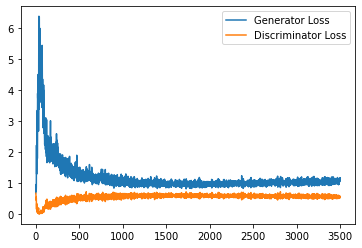

Step 70500: Generator loss: 1.0823232700824739, discriminator loss: 0.5643382791876793


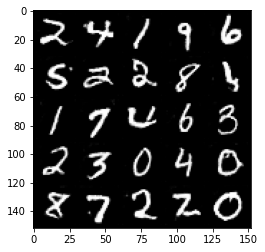

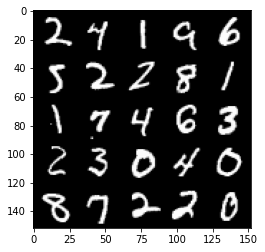

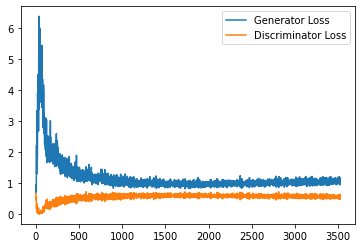

Step 71000: Generator loss: 1.063298288345337, discriminator loss: 0.5566417310833931


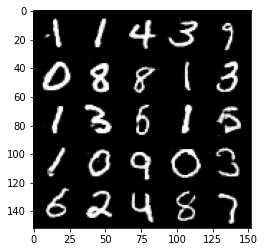

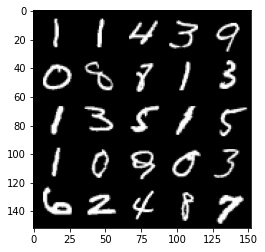

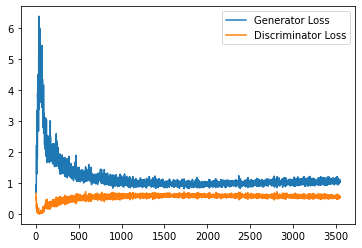

Step 71500: Generator loss: 1.0871932134628295, discriminator loss: 0.5579523884057999


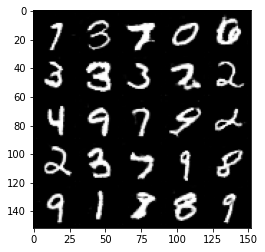

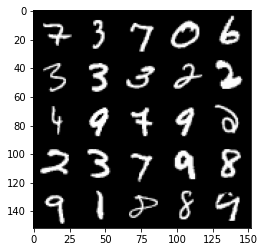

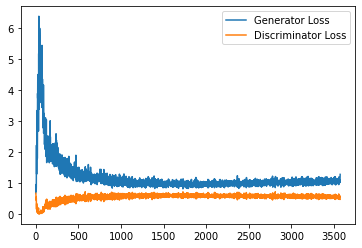

Step 72000: Generator loss: 1.0695200382471084, discriminator loss: 0.5676196854114532


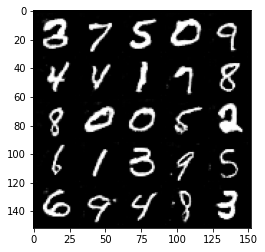

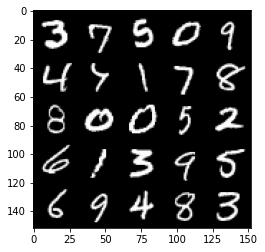

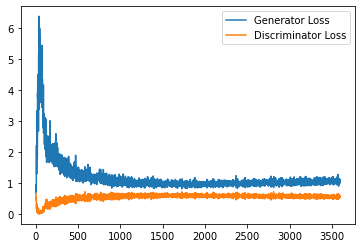

Step 72500: Generator loss: 1.0999267652034759, discriminator loss: 0.557274424791336


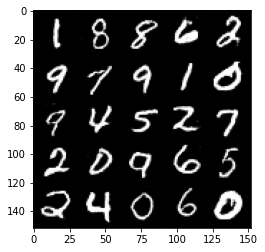

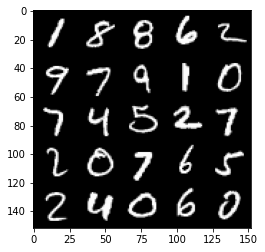

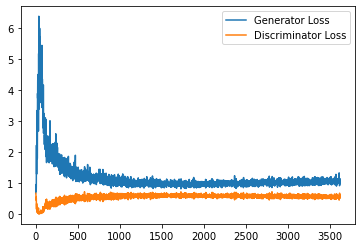

Step 73000: Generator loss: 1.0812468500137329, discriminator loss: 0.5656030287742615


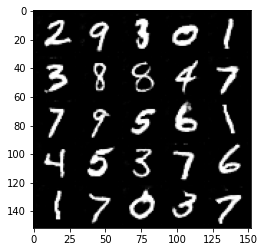

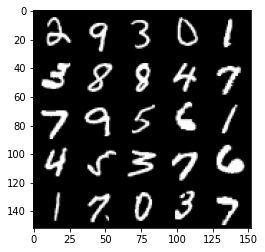

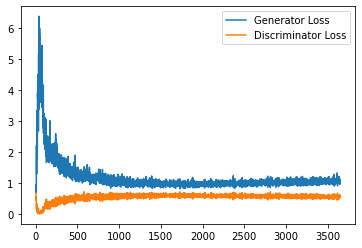

Step 73500: Generator loss: 1.0767301894426347, discriminator loss: 0.5575606549978256


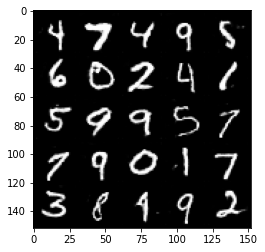

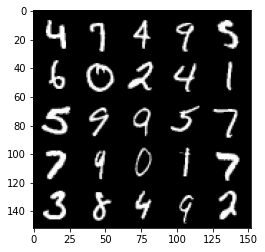

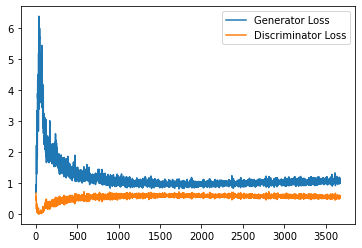

Step 74000: Generator loss: 1.0797711552381515, discriminator loss: 0.5573782619833946


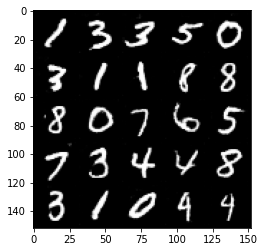

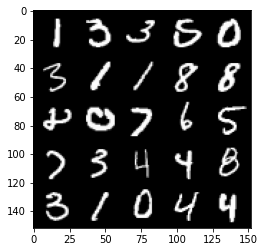

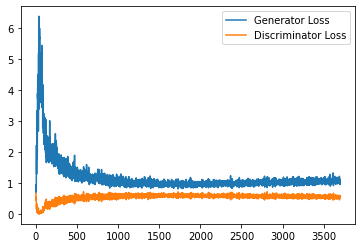

Step 74500: Generator loss: 1.0880957989692688, discriminator loss: 0.5624437373876572


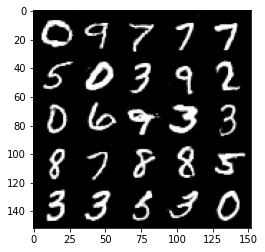

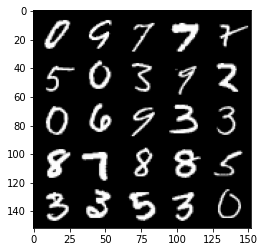

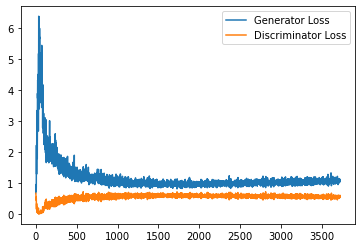

Step 75000: Generator loss: 1.0757224178314209, discriminator loss: 0.5564542934298515


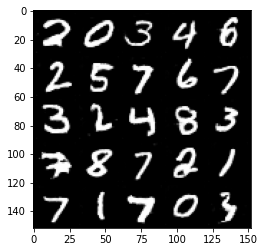

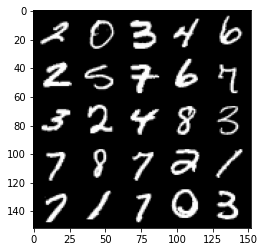

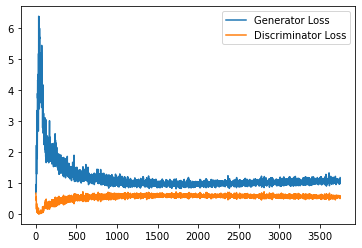

Step 75500: Generator loss: 1.0867959597110748, discriminator loss: 0.5612245891094207


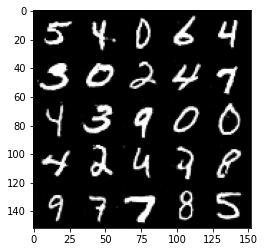

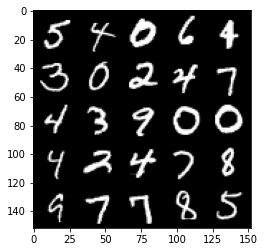

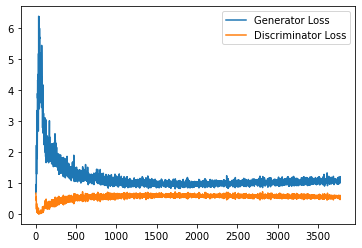

Step 76000: Generator loss: 1.0831790499687195, discriminator loss: 0.5591648554801941


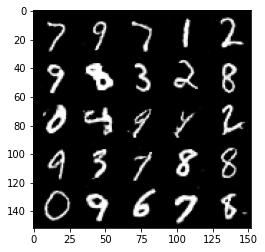

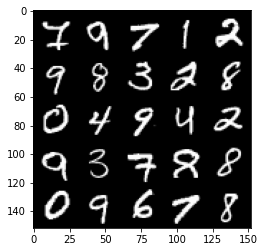

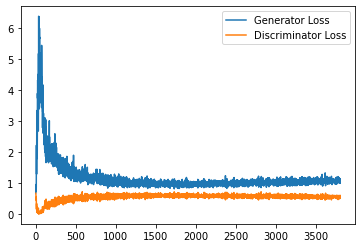

Step 76500: Generator loss: 1.070782342672348, discriminator loss: 0.553818756699562


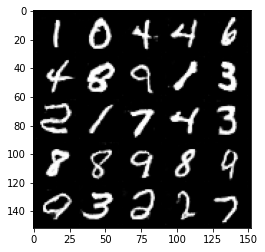

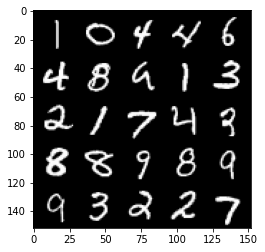

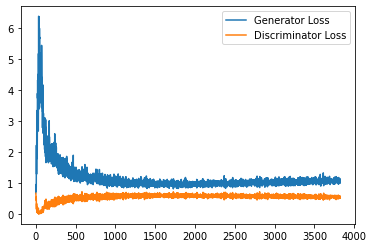

Step 77000: Generator loss: 1.0901379123926163, discriminator loss: 0.5612818829417229


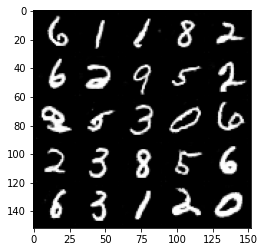

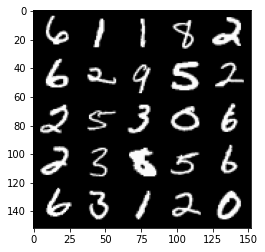

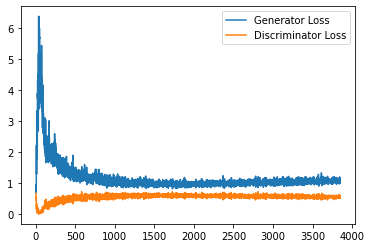

Step 77500: Generator loss: 1.1012965923547744, discriminator loss: 0.558779303252697


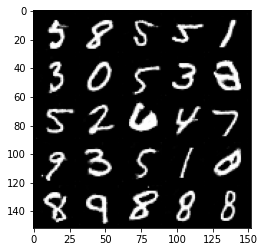

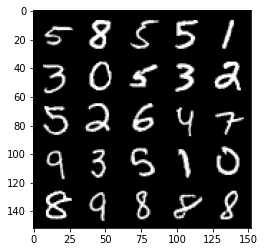

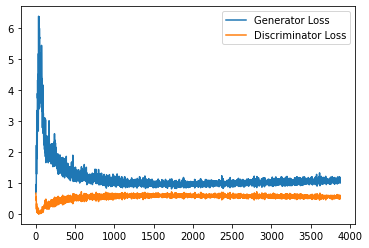

Step 78000: Generator loss: 1.0980026227235795, discriminator loss: 0.555788520693779


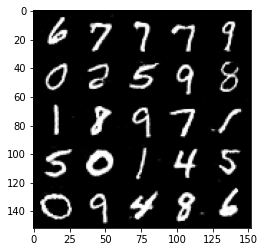

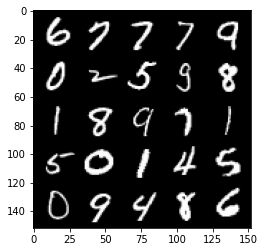

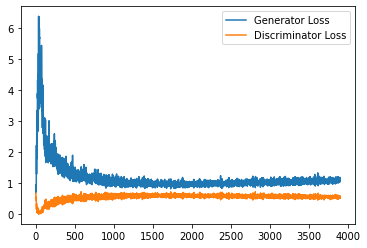

Step 78500: Generator loss: 1.091609719157219, discriminator loss: 0.5555194703936577


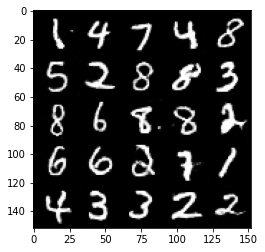

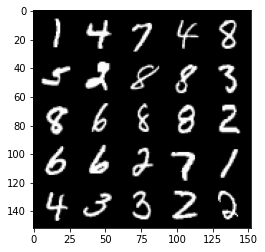

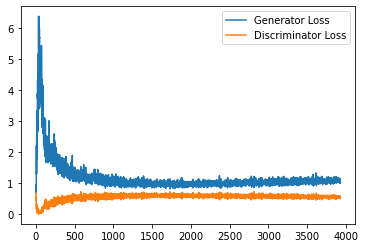

Step 79000: Generator loss: 1.1082042897939681, discriminator loss: 0.556136474609375


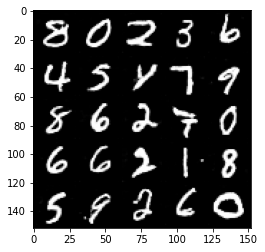

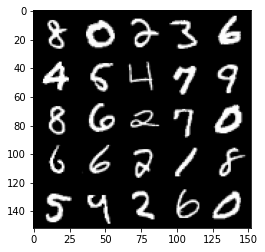

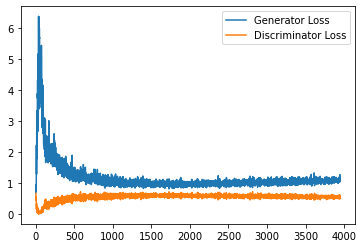

Step 79500: Generator loss: 1.0950676428079604, discriminator loss: 0.5552177275419236


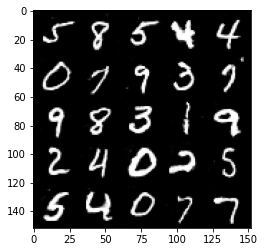

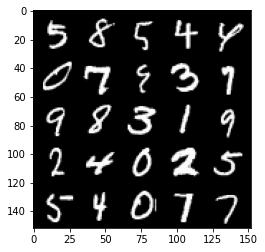

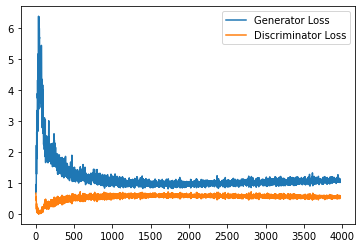

Step 80000: Generator loss: 1.0908832539319993, discriminator loss: 0.5556549339294433


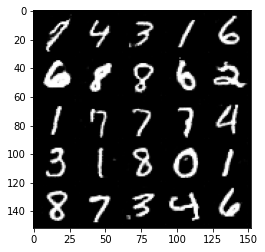

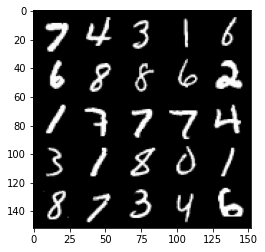

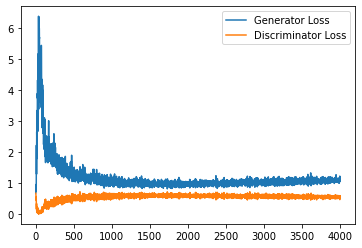

Step 80500: Generator loss: 1.1151184583902358, discriminator loss: 0.5574209226369857


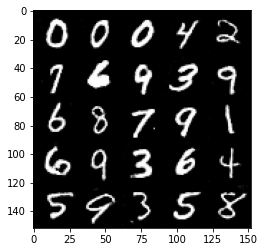

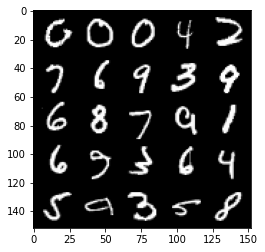

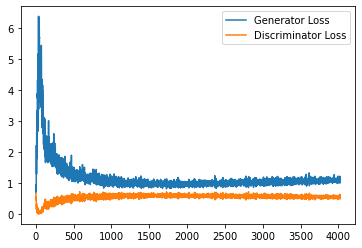

Step 81000: Generator loss: 1.1192005186080933, discriminator loss: 0.5508489850163459


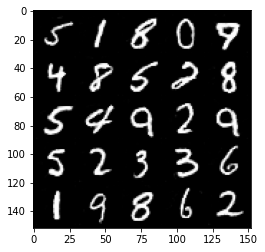

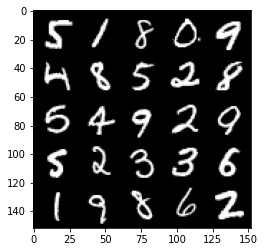

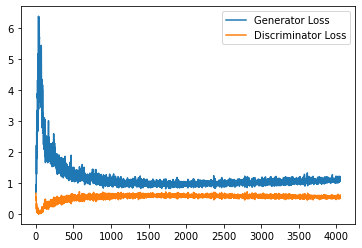

Step 81500: Generator loss: 1.1297026178836822, discriminator loss: 0.5502251873612404


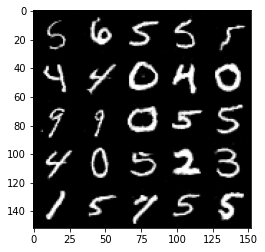

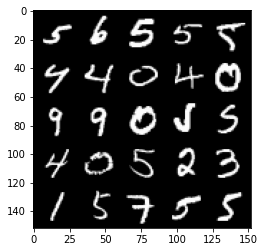

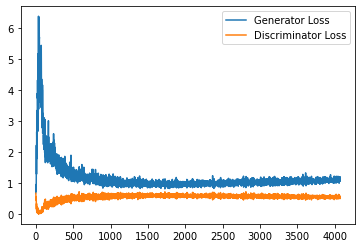

Step 82000: Generator loss: 1.1030773864984513, discriminator loss: 0.5551029205322265


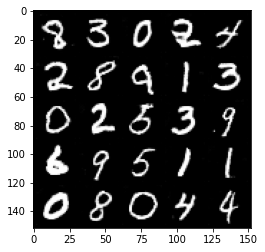

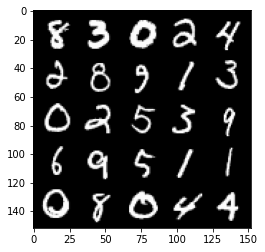

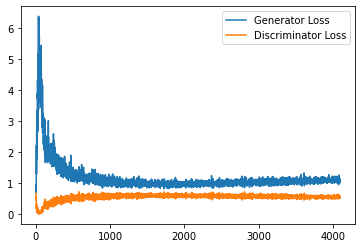

Step 82500: Generator loss: 1.1110848838090897, discriminator loss: 0.5498904519677162


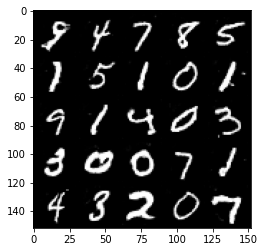

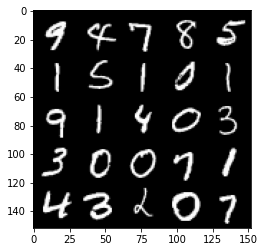

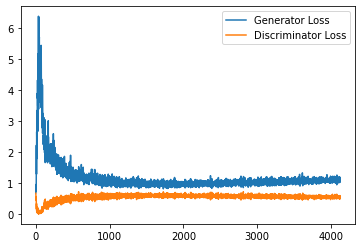

Step 83000: Generator loss: 1.1190612847805024, discriminator loss: 0.5480717177987099


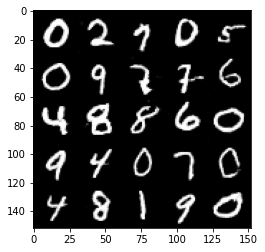

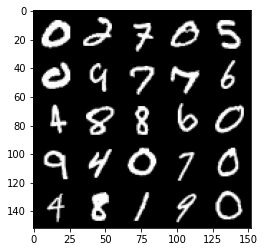

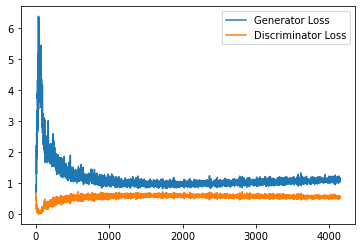

Step 83500: Generator loss: 1.1192810535430908, discriminator loss: 0.5508621429800987


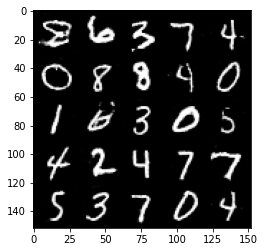

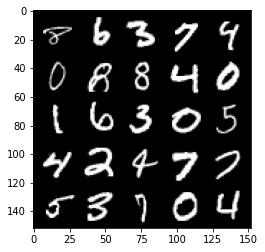

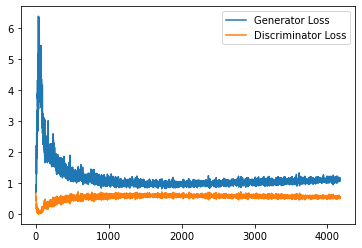

Step 84000: Generator loss: 1.1217875454425812, discriminator loss: 0.5467303374409676


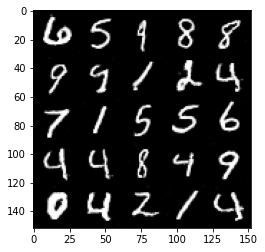

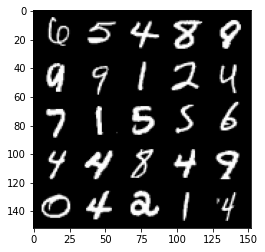

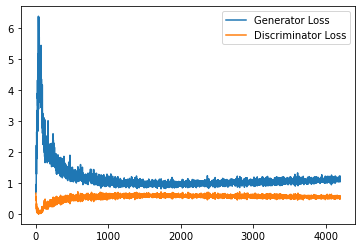

Step 84500: Generator loss: 1.119725254535675, discriminator loss: 0.5567087981700897


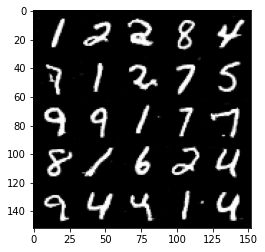

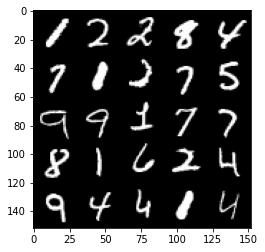

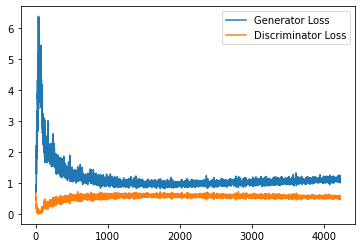

Step 85000: Generator loss: 1.11912162733078, discriminator loss: 0.5476230640411377


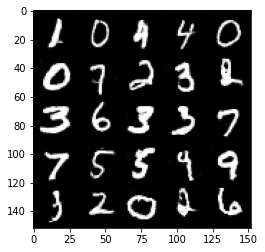

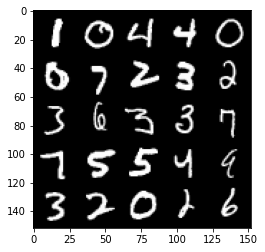

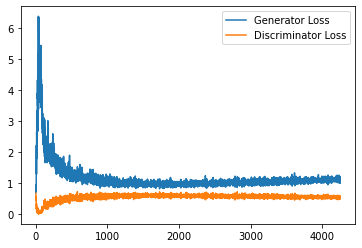

Step 85500: Generator loss: 1.1167141193151473, discriminator loss: 0.5496721880435944


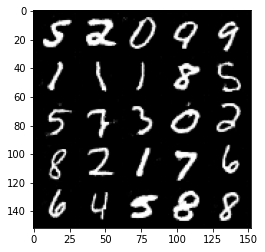

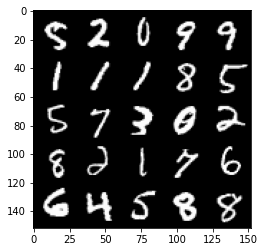

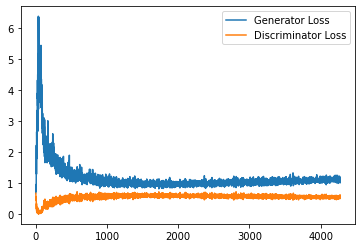

Step 86000: Generator loss: 1.1302206964492798, discriminator loss: 0.5489776859879494


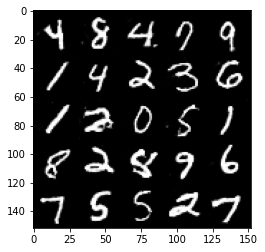

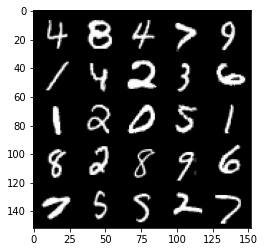

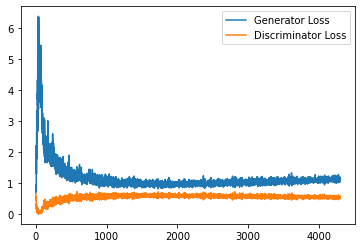

Step 86500: Generator loss: 1.118319523692131, discriminator loss: 0.5432459114193916


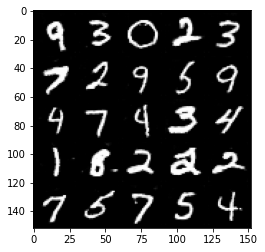

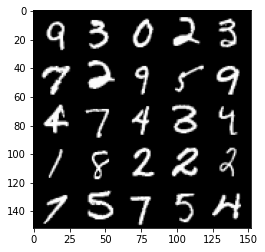

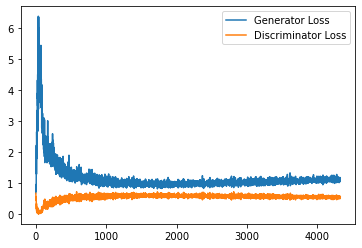

Step 87000: Generator loss: 1.142831114768982, discriminator loss: 0.5431767375469208


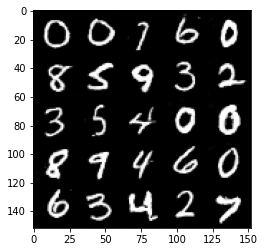

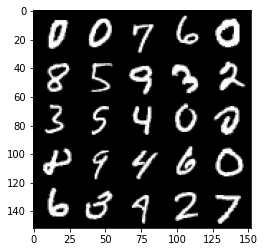

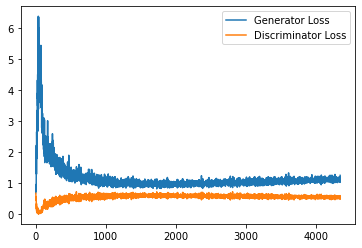

Step 87500: Generator loss: 1.1305721901655197, discriminator loss: 0.5429873640537262


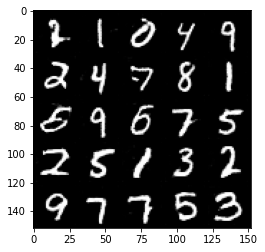

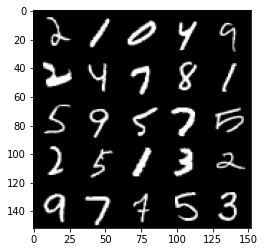

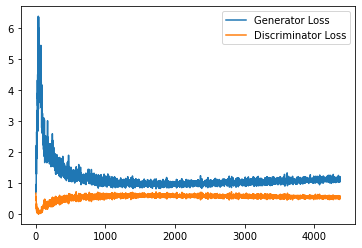

Step 88000: Generator loss: 1.1401054289340973, discriminator loss: 0.5441461212038994


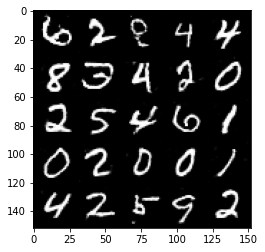

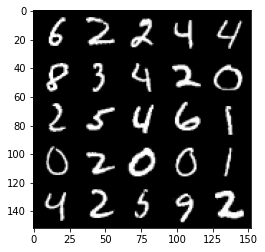

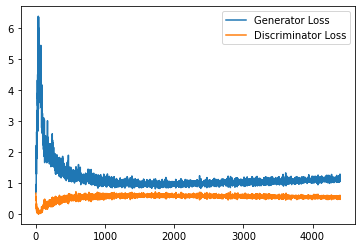

Step 88500: Generator loss: 1.1519134473800658, discriminator loss: 0.5480599077343941


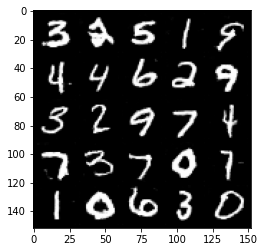

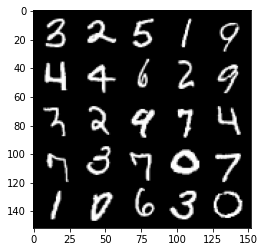

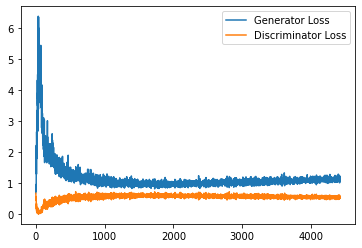

Step 89000: Generator loss: 1.1365207848548888, discriminator loss: 0.5457935348153115


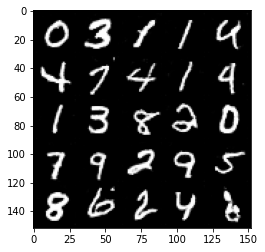

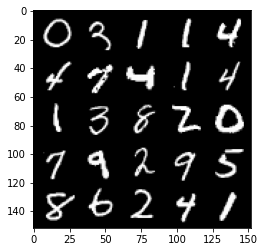

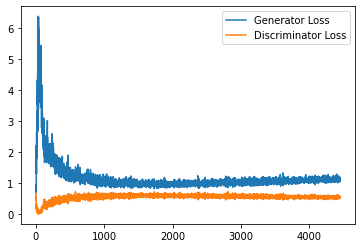

Step 89500: Generator loss: 1.1398793818950652, discriminator loss: 0.5463912529349327


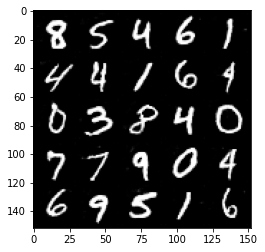

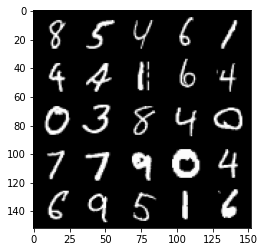

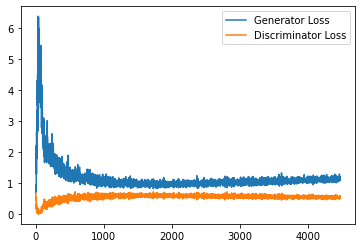

Step 90000: Generator loss: 1.139316213965416, discriminator loss: 0.5445506531000137


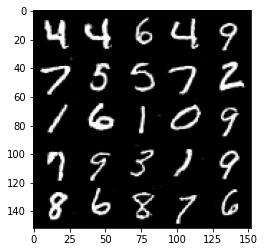

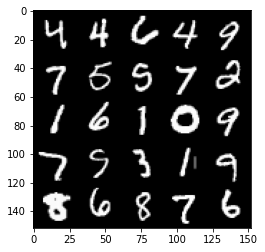

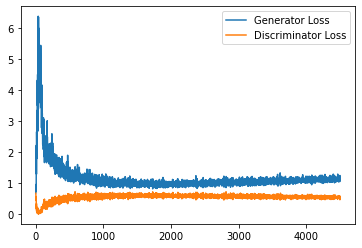

Step 90500: Generator loss: 1.1440345110893249, discriminator loss: 0.5450926395058632


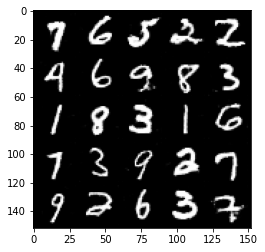

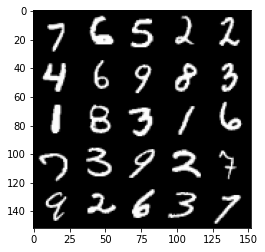

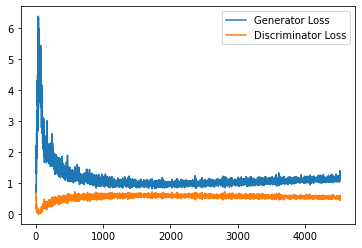

Step 91000: Generator loss: 1.14553486597538, discriminator loss: 0.5428959589600563


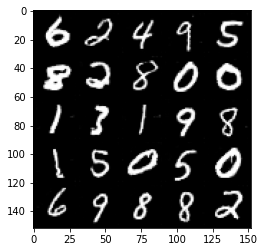

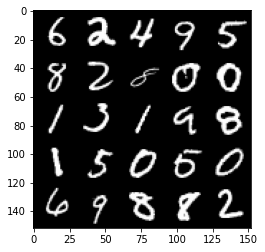

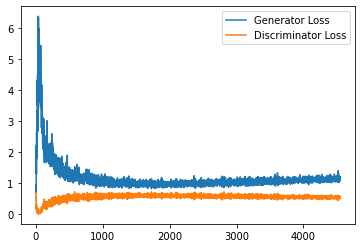

Step 91500: Generator loss: 1.1528190344572067, discriminator loss: 0.5360309865474701


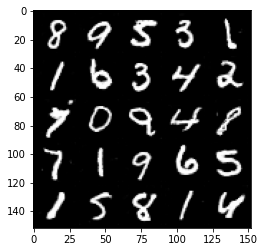

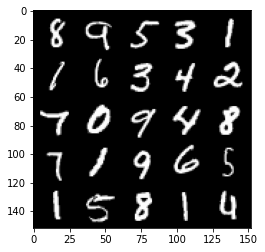

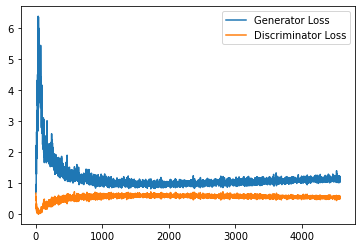

Step 92000: Generator loss: 1.1599992916584014, discriminator loss: 0.5372679128050805


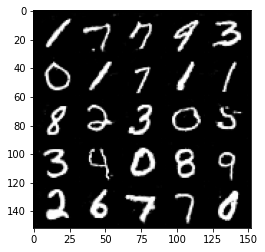

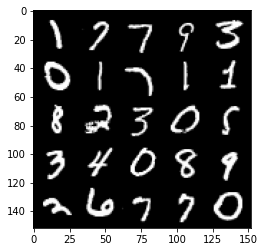

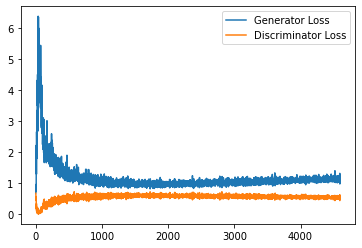

Step 92500: Generator loss: 1.1555866649150848, discriminator loss: 0.5394009057283401


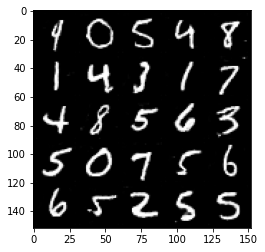

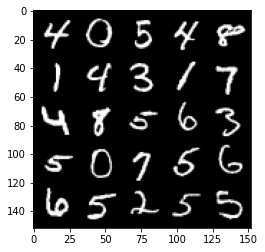

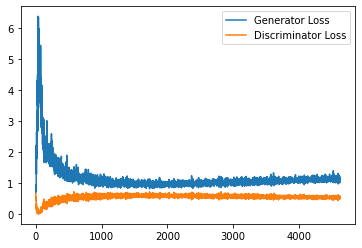

Step 93000: Generator loss: 1.1749706120491028, discriminator loss: 0.5356287333369255


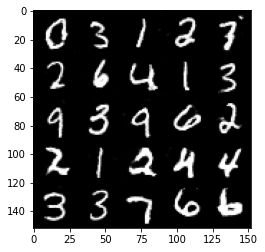

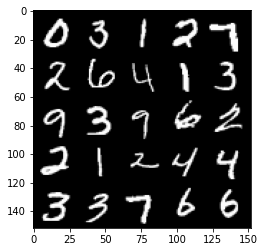

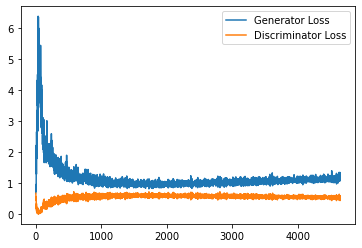

Step 93500: Generator loss: 1.1599584283828734, discriminator loss: 0.5422806621193886


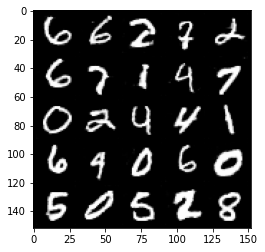

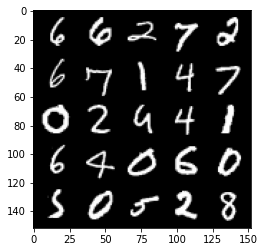

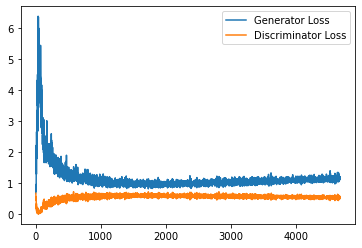

In [ ]:
cur_step = 0
generator_losses = []
discriminator_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])
        disc_opt.zero_grad()
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        noise_and_labels = combine_vectors(fake_noise,one_hot_labels)
        fake = gen(noise_and_labels)
        fake_image_and_labels = combine_vectors(fake,image_one_hot_labels).detach()
        real_image_and_labels = combine_vectors(real,image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
     
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()
        generator_losses += [gen_loss.item()]

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [ ]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

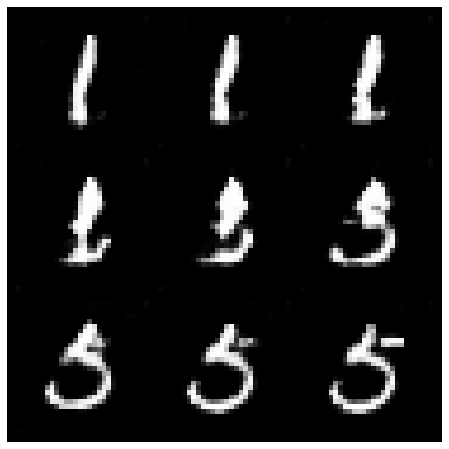

In [ ]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

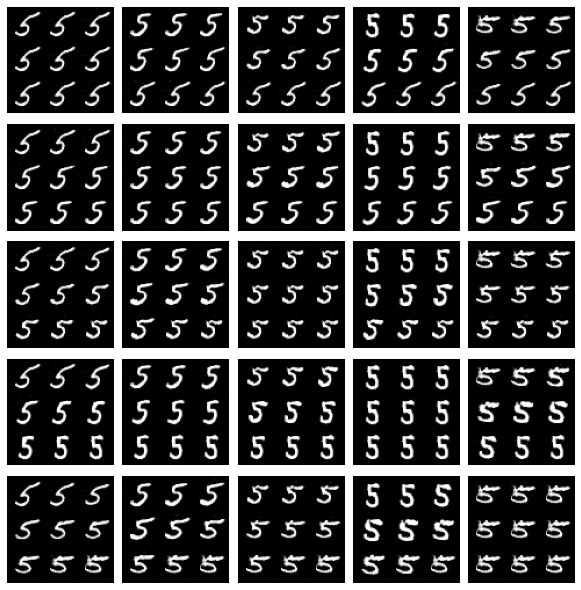

In [ ]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()